For import **analytics-utils** package, execute the commands below:

```
pip install git+https://github.com/patricksferraz/analytics-utils.git
```

In [211]:
from analytics_utils.partial_autocorrelation import partial_autocorrelation
from analytics_utils.autocorrelation import autocorrelation
from analytics_utils.regressors import logistic_regression
from analytics_utils.regressors import GeneralizedLinear
from analytics_utils.describe_data import describe_data
from analytics_utils.interpolate import interpolate
from analytics_utils.decomposers import seasonal
from analytics_utils.correlate import correlate
from analytics_utils.regressors import arima
from analytics_utils.decomposers import ssa
from analytics_utils.roll import roll
from analytics_utils.ewm import ewm
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_pacf
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.tsa.stattools import adfuller
from sklearn.metrics import mean_absolute_error as mae
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from tensorflow.keras import backend as K
import matplotlib.pyplot as plt
import tensorflow as tf
import seaborn as sns
import pandas as pd
import numpy as np

---

## 1 - Global variables

In [212]:
# Files paths
ARGS = {
    "headers": "dataset/header.csv",
    "train": "dataset/outer.csv",
}

In [213]:
# Columns names
HEADERS = pd.read_csv(ARGS['headers'], header=None).iloc[0]
HEADERS

0     datetime
1           co
2          Lat
3         Long
4          day
5        month
6         year
7         hour
8          gmt
9          no2
10          o3
11        pm10
12        pm25
13         so2
Name: 0, dtype: object

In [214]:
# Dataset columns of interest
COLUMNS = HEADERS
COLUMNS

0     datetime
1           co
2          Lat
3         Long
4          day
5        month
6         year
7         hour
8          gmt
9          no2
10          o3
11        pm10
12        pm25
13         so2
Name: 0, dtype: object

In [215]:
# Offset for resize the plot
OFFSET = 200

---

## 2 - Functions

### 2.1 - Third-party functions

__plot_distributions__
- dataset: dataframe with dataset

In [216]:
# Third-party function (Lucas Alves)
def plot_distributions(dataset):
    dataset_columns = list(dataset.columns.values)
    plt_col_num = 2
    plt_row_num = len(dataset_columns)
    
    plt.figure(figsize=(15, plt_row_num*5))
    
    for index, label in enumerate(dataset_columns):
        # Subplot for histogram and KDE
        plt.subplot(plt_row_num, plt_col_num, (2*index)+1)
        
        # Plot histogram
        ax1 = sns.distplot(dataset.loc[:, label].dropna(), hist=True, kde=False)
        ax1.set_ylabel('Frequência')
        
        # Plot KDE (Kernel Density Estimation)
        ax2 = ax1.twinx()
        sns.distplot(dataset.loc[:, label].dropna(), hist=False, kde=True, ax=ax2)
        ax2.set_ylabel('Densidade de Probabilidade Estimada')

        # Computation of data statistics
        median = dataset.loc[:, label].median()
        quartile_1 = dataset.loc[:, label].quantile(q=0.25)
        quartile_3 = dataset.loc[:, label].quantile(q=0.75)
        min_val = dataset.loc[:, label].min()
        max_val = dataset.loc[:, label].max()
        inf_limit = max(min_val, (quartile_1 - (quartile_3-quartile_1)*1.5))
        sup_limit = min(max_val, (quartile_3 + (quartile_3-quartile_1)*1.5))
        
        # Computation of outliers
        inf_outliers = dataset.loc[dataset.loc[:, label]<inf_limit, :].shape[0]
        sup_outliers = dataset.loc[dataset.loc[:, label]>sup_limit, :].shape[0]
        inf_outliers_percent = (inf_outliers/dataset.loc[:, label].dropna().shape[0])
        sup_outliers_percent = (sup_outliers/dataset.loc[:, label].dropna().shape[0])
        
        # Plot lines indicating the statistics
        plt.axvline(x=median, linestyle='-', linewidth=1.3, color='black', label='Mediana')
        plt.axvline(x=quartile_1, linestyle='-', linewidth=1.3, color='green', label='1º Quartil')
        plt.axvline(x=quartile_3, linestyle='-', linewidth=1.3, color='green', label='3º Quartil')
        plt.axvline(x=inf_limit, linestyle='-', linewidth=1.3, color='red',
                    label='Limite inferior\n{:.2%} dos dados abaixo'.format(inf_outliers_percent))
        plt.axvline(x=sup_limit, linestyle='-', linewidth=1.3, color='red',
                    label='Limite superior\n{:.2%} dos dados acima'.format(sup_outliers_percent))
        plt.legend()
        
        # Plot boxplot in other subplot
        plt.subplot(plt_row_num, plt_col_num, (2*index)+2)
        dataset.boxplot(column=label)
        plt.ylabel('Valores')
        plt.title('')
        plt.grid(True)
        
    plt.subplots_adjust(wspace=0.35, hspace=0.3)
    plt.show()

### 2.2 - Third party functions ai_utils

In [217]:
def R_squared(y_true, y_pred):
    y_true_mean = y_true.mean()
    y_pred_mean = y_pred.mean()

    sum_num = np.sum((y_pred-y_pred_mean)*y_true)
    numerator = np.square(sum_num)

    ypm_square = np.square(y_pred - y_pred_mean)
    ytm_square = np.square(y_true - y_true_mean)
    denominator = np.sum(ypm_square) * np.sum(ytm_square)
    
    return numerator/denominator

In [218]:
def fac2(y_true, y_pred):
    min_ = 0.5
    max_ = 2

    division = tf.divide(y_pred, y_true)

    greater_min = tf.greater_equal(division, min_)
    less_max = tf.less_equal(division, max_)

    res = tf.equal(greater_min, less_max)
    res = tf.cast(res, tf.float32)

    fac_2 = tf.reduce_mean(res)

    return K.get_value(fac_2)

In [219]:
def pearson_r(y_true, y_pred):
    y_true_mean = y_true.mean()
    y_pred_mean = y_pred.mean()

    diff_yt = y_true - y_true_mean
    diff_yp = y_pred - y_pred_mean

    numerator = np.sum((diff_yt) * (diff_yp))
    denominator = np.sqrt(np.sum(np.square(diff_yt))) * np.sqrt(np.sum(np.square(diff_yp)))

    return numerator/denominator

---

### 2.3 - Others functions

__dftest__
- df: dataframe with dataset

In [220]:
# Perform Dickey-Fuller test:
def _dftest(df):
    print('Results of Dickey-Fuller Test:')
    dftest = adfuller(df, autolag='AIC')
    dfoutput = pd.Series(
        dftest[0:4],
        index=['Test Statistic','p-value','#Lags Used','Number of Observations Used']
    )
    for key,value in dftest[4].items():
        dfoutput[f'Critical Value ({key})'] = value
    print(dfoutput)

__class_evaluate__
- true: true values of dataset
- pred: forecasting values

In [221]:
# Function for evaluate classification problem
def _class_evaluate(true, pred):
    # Confusion matrix
    cm = pd.DataFrame(confusion_matrix(true, pred))
    
    # Metrics (precision, recall, f1)
    pc = precision_score(true, pred, average=None)
    rc = recall_score(true, pred, average=None)
    f1 = f1_score(true, pred, average=None)
    # Accuracy
    ac = accuracy_score(true, pred)
    # Df with the metrics
    all_m = pd.DataFrame({
        "precision": pc,
        "recall": rc,
        "f1": f1
    })
    
    return cm, all_m, ac

__regress_evaluate__
- true: true values of dataset
- pred: forecasting values
- index: column name of forecasting

In [222]:
# Function for evaluating regression problem
def _regress_evaluate(true, pred, index):
    return pd.DataFrame([{
        "r_squared": R_squared(true, pred),
        "fac_2": fac2(true, pred),
        "pearson_r": pearson_r(true, pred),
        "mae": mae(true, pred),
        "mse": mse(true, pred),
        "min_error": np.amin(np.absolute(true - pred)),
        "max_error": np.amax(np.absolute(true - pred)),
    }], index=[index])

__mult_regress_evaluate__
- true: true values of dataset
- regress: forecasting values
- linear_type: linear type

In [223]:
# Function for evaluating regression problem with multiple regressions values
def _mult_regress_evaluate(true, regress, linear_type):
    evaluates = pd.DataFrame()
    for _ in regress:
        evaluate = _regress_evaluate(
            true[_+1:].values,
            regress[_][:-(_+1)].values,
            f"{linear_type} ({_+1}-Hour)"
        )
        evaluates = pd.concat([evaluates, evaluate])
        
    return evaluates

---

### 2.4 - Plot functions

__describe_lineplot__
- df: dataframe of dataset
- describe: dataframe after describe_data function
- measures: columns of describe for measure
- xlabel: name of x axis

In [224]:
# Function for lineplot chart (described datas)
def _describe_lineplot(df, describe, measures, xlabel='time'):
    for column in df:
        
        # Copy dataframe and insert {measures}
        df_aux = df[[column]].copy()
        for measure in measures:
            df_aux[f"{measure}"] = describe.loc[column, measure]

        # Pre calculate
        _max = df_aux[column].max()
        _min = df_aux[column].min()
        q1 = describe.loc[column, "1-quartil"]
        q3 = describe.loc[column, "3-quartil"]
        irq = q3 - q1

        # Calculate lower and upper limit
        df_aux["limite_superior"] = min(_max, q3+(1.5*irq))
        df_aux["limite_inferior"] = max(_min, q1-(1.5*irq))

        # Plot df
        _, ax1 = plt.subplots(1, 1, figsize=(15, 5))
        ax = sns.lineplot(data=df_aux, ax=ax1)
        ax.set(xlabel=xlabel, ylabel=column)

__mlineplot__
- df: dataframe of dataset
- predict: forecasting values with your confidence interval
- title: chart title
- xlabel: name of x axis
- true_offset: offset for interval size, if 0, show all

In [225]:
# Function for multline plot        
def _mlineplot(df, predict=None, title=None, xlabel='time', true_offset=0, conf_interval=False):
    
    if predict is not None:
        # Size of true and predict
        size_fc = predict.shape[0]
        size_tr = df[:-size_fc].shape[0]

        # Index of forecasting
        index_fc = np.arange(size_tr, size_tr+size_fc)
        predict.index = index_fc
    
    for column in df:

        # Plot
        _, ax = plt.subplots(1, 1, figsize=(15,5))
        ax.plot(df[[column]][true_offset:], label=column)

        if predict is not None:
            # Make series for plotting purpose
            fc_series = predict[f"{column}_pred"]
            ax.plot(fc_series, color='darkgreen', label=f'{column}_fc')
            
            if conf_interval:
                lw_series = predict[f"{column}_lconf"]
                up_series = predict[f"{column}_uconf"]

                ax.fill_between(
                    lw_series.index,
                    lw_series,
                    up_series,
                    color='k',
                    alpha=.15,
                    label="conf_interval"
                )
        
        ax.set(xlabel=xlabel, ylabel=column)
        ax.legend()
        
        plt.title(title[column] if title is not None else column)
        plt.show()

__acfplot__
- df: dataframe of dataset
- lags: lag size

In [226]:
# Function for plot acf autocorrelate
def _acfplot(df, lags=12):
    for column in df:
        ax = plot_acf(
            df[[column]],
            lags=lags,
            title=f'{column} - Autocorrelation',
        )
        ax.set_size_inches(15,5)

__pacfplot__
- df: dataframe of dataset
- lags: lag size

In [227]:
# Function for plot acf autocorrelate
def _pacfplot(df, lags=12):
    for column in df:
        ax = plot_pacf(
            df[[column]],
            lags=lags,
            title=f'{column} - Partial Autocorrelation'
        )
        ax.set_size_inches(15,5)

__corrplot__
- df: dataframe of dataset

In [228]:
# Function for plot heatmap
def _corrplot(df):
    corr = correlate(df_inter)
    mask = np.zeros_like(corr)
    mask[np.triu_indices_from(mask)] = True

    with sns.axes_style("white"):
        _, ax1 = plt.subplots(1, 1, figsize=(15, 5))
        ax = sns.heatmap(
            corr,
            mask=mask,
            vmin=-1,
            vmax=1,
            annot=True,
            cmap='coolwarm',
            square=True,
            linewidths=.5,
            ax=ax1,
        )

__rollplot__
- df: dataframe of dataset
- xlabel: name of x axis

In [229]:
# Function for plot evolution chart with rolling and adftest
def _rollplot(df, xlabel='time'):
    # Determing rolling statistics
    rolmean = roll(df, 12, roll_type="mean")
    rolstd = roll(df, 12, roll_type="std")

    # Calculate moving mean and moving std
    for column in df:
        df_aux = pd.concat(
            [
                df[[column]],
                rolmean[column].rename("média móvel"),
                rolstd[column].rename("desvio médio")
            ],
            axis=1
        )

        # Plot df
        _, ax1 = plt.subplots(1, 1, figsize=(15, 5))
        ax = sns.lineplot(data=df_aux, ax=ax1)
        ax.set(xlabel=xlabel, ylabel=column)
        plt.show(block=False)
    
        #Perform Dickey-Fuller test:
        _dftest(df_aux[column])

__seasonalplot__
- df: dataframe of dataset
- model: Type of seasonal component - “additive” or “multiplicative”

In [230]:
# Function for plot seasonal decompose
def _seasonalplot(df, model='additive'):
    for column in df:
        ax = seasonal_decompose(
            df[column], freq=12, model=model
        ).plot()
        ax.set_size_inches(15,5)
        plt.xlabel(column)

__ssaplot__
- df: dataframe of dataset
- decompose: dataframe with decompose values after apply ssa

In [231]:
def _ssaplot(df, decompose):
    group_size = decompose.shape[0]

    for column in decompose:
        plt.figure(figsize=(15, 5))

        ax1 = plt.subplot(111)
        ax1.plot(df[column], '-', label=column)
        ax1.legend(fontsize=14)

        plt.suptitle('Singular Spectrum Analysis', fontsize=20)
        plt.tight_layout()
        plt.subplots_adjust(top=0.88)
        plt.show()

        plt.figure(figsize=(15, 5))

        ax2 = plt.subplot(121)
        ax2.plot(decompose[column][0], '--', label='SSA 1')
        ax2.legend(fontsize=14)

        ax3 = plt.subplot(122)
        for i in range(1, group_size):
            ax3.plot(decompose[column][i], '--', label='SSA {0}'.format(i + 1))
        ax3.legend(fontsize=14)

        plt.tight_layout()
        plt.subplots_adjust(top=0.88)
        plt.show()

__regressplot__
- df: dataframe of dataset
- regress: dataframe with regresses values

In [232]:
def _regressplot(df, regress):
    for _ in regress:
        fig, ax1 = plt.subplots(1, 1, figsize=(15, 5))
        data = pd.concat(
            [df[_+1:], regress[_][:-(_+1)]],
            join="inner",
            axis=1
        )
        ax = sns.lineplot(
            data=data,
            ax=ax1
        )
        plt.show()

---

## 3 - Load and show datas

In [233]:
# Load dataset
_t = pd.read_csv(ARGS['train'], parse_dates=['datetime'], header=None, names=HEADERS, index_col="datetime")
# _p = pd.read_csv(ARGS['pred'], delimiter='\t', header=None, names=HEADERS)
df_m = _t
df_m = df_m.sort_values("datetime")
df_m = df_m.drop("gmt", axis=1)
HEADERS = HEADERS.drop(labels=[0, 8])
COLUMNS = HEADERS
df_m

,co,Lat,Long,day,month,year,hour,no2,o3,pm10,pm25,so2
datetime,,,,,,,,,,,,
2016-03-06 19:00:00,NaN,33.820000,-117.913100,6,3,2016,19,NaN,0.047,17.0,6.0,NaN
2016-03-06 19:00:00,NaN,33.674400,-117.929400,6,3,2016,19,NaN,0.052,NaN,NaN,NaN
2016-03-06 19:00:00,NaN,34.199200,-118.533100,6,3,2016,19,NaN,0.050,NaN,13.0,NaN
2016-03-06 19:00:00,NaN,34.066700,-117.750600,6,3,2016,19,NaN,0.046,NaN,NaN,NaN
2016-03-06 19:00:00,NaN,34.066900,-118.241700,6,3,2016,19,NaN,0.047,26.0,7.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
2019-10-04 12:00:00,0.46,34.132630,-118.127144,4,10,2019,12,0.026,0.006,NaN,NaN,NaN
2019-10-04 12:00:00,0.77,33.802418,-118.219930,4,10,2019,12,0.022,0.000,NaN,NaN,0.0
2019-10-04 12:00:00,0.49,33.955070,-118.430460,4,10,2019,12,0.027,0.002,NaN,NaN,0.0


In [195]:
# # Parser dates
# dateparse = lambda r: pd.to_datetime(
#     f"{int(r['Ano'])}-{int(r['Mês'])}-{int(r['Dia'])} {int(r['Hora'])}:00:00"
# )
# df_m["Data"] = df_m.apply(dateparse, axis=1)
# df_m = df_m.set_index("Data")
# df_m

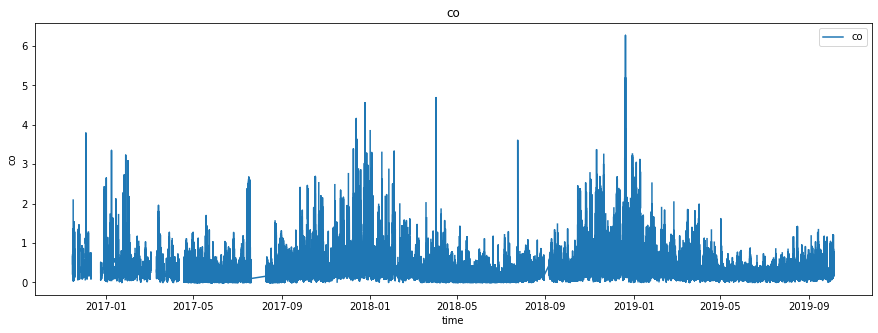

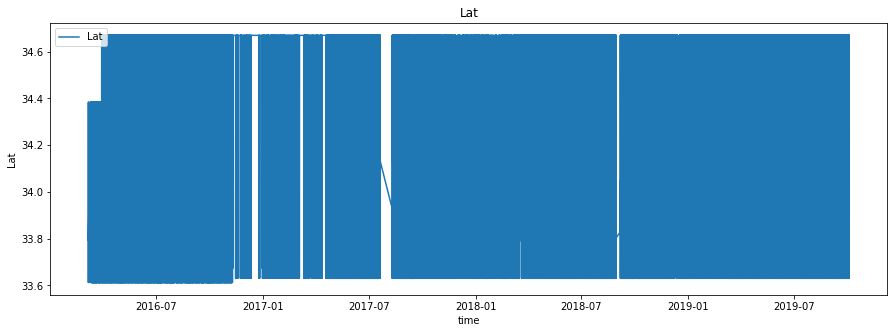

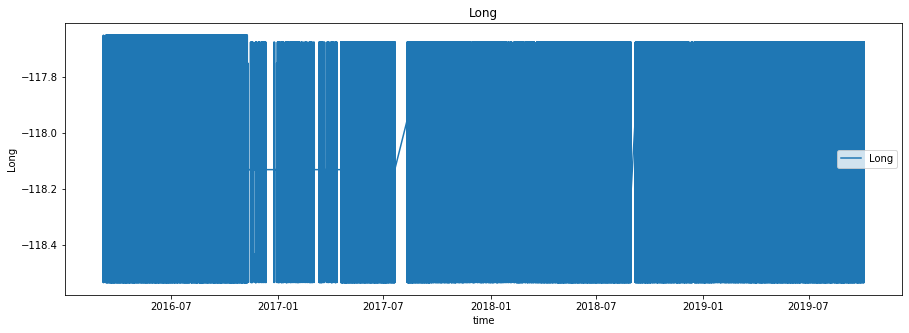

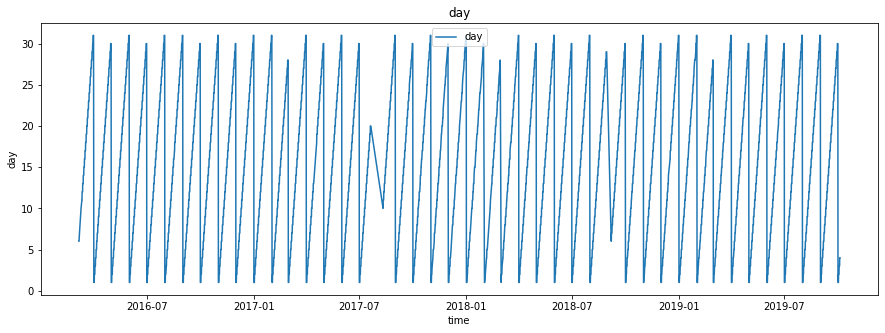

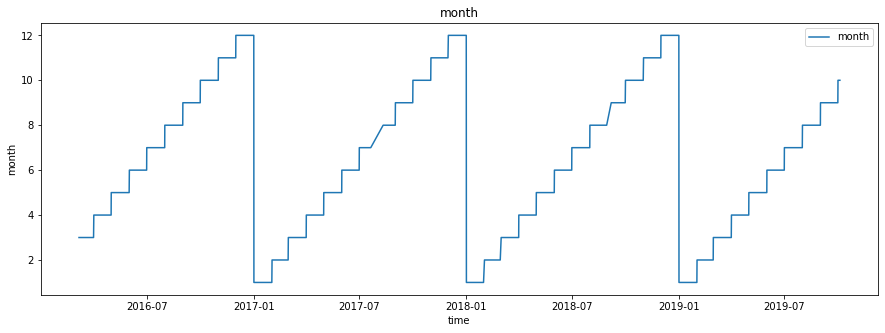

...

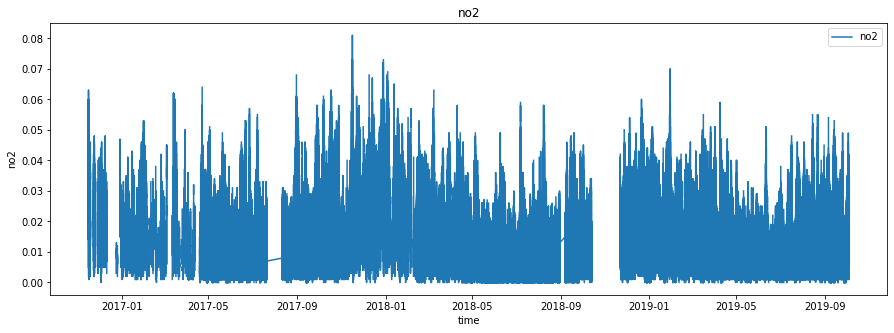

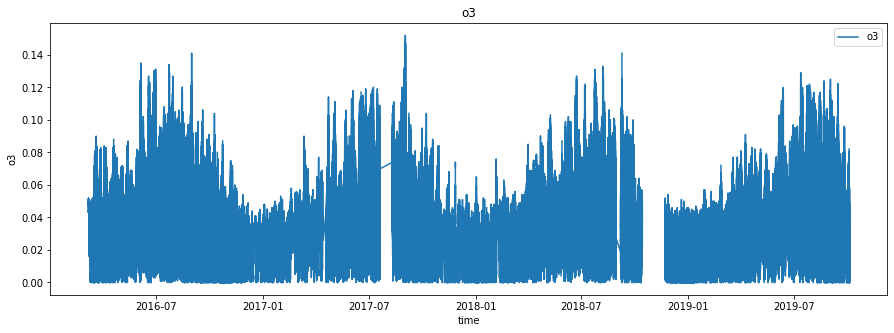

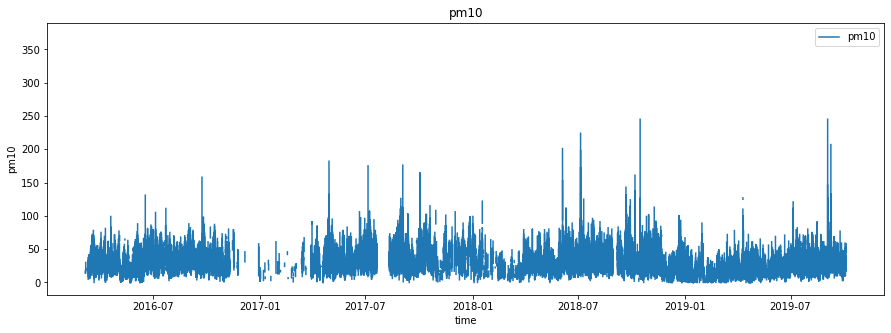

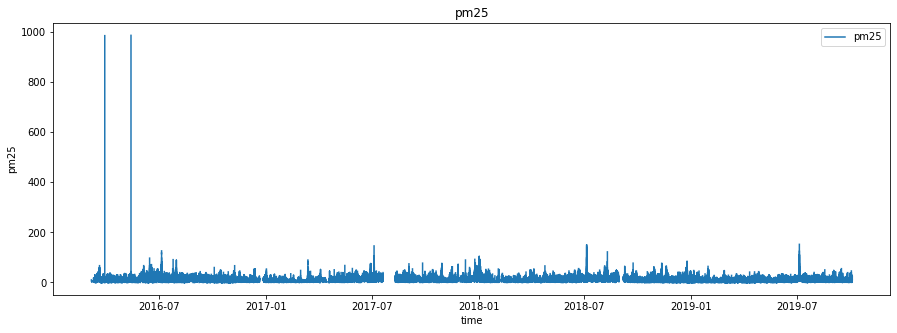

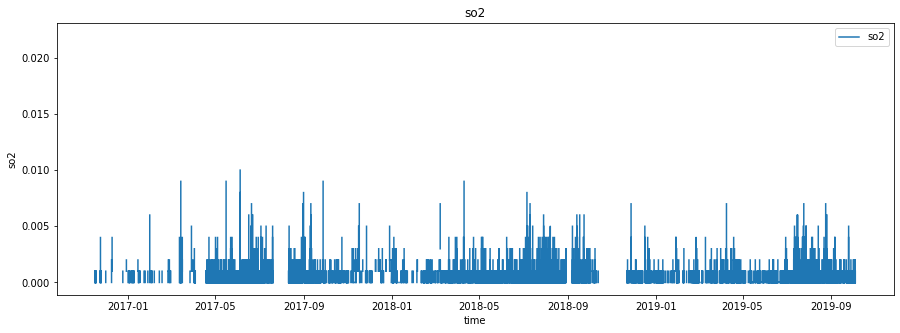

In [196]:
# Show evolution chart
_mlineplot(df_m[COLUMNS])

---

## 4 - Preprocessing (nan values)

__describe_data__
- data_frame: dataframe with dataset
- lang: output column language, "pt" or "en" (default: 'pt')
- headers: columns name for describe, if None describes all columns

In [197]:
describe_data(df_m)

,max,min,média,mediana,limite inferior,1-quartil,3-quartil,limite superior,variância,desvio padrão,desvio absoluto,amplitude,rms,curtose,assimetria,contagem,NaNs
cabeçalho,,,,,,,,,,,,,,,,,
co,6.27000,0.0000,0.287666,0.230000,0.0000,0.160000,0.350000,0.635000,5.265385e-02,0.229464,0.145937,6.27000,0.367975,28.345841,3.755273,173320,130532
Lat,34.66959,33.6125,34.040839,34.051098,33.6125,33.830585,34.143900,34.613873,6.413399e-02,0.253247,0.191247,1.05709,34.041781,0.609162,0.772963,303852,0
Long,-117.65170,-118.5331,-118.124020,-118.130690,-118.5331,-118.241700,-117.923965,-117.651700,6.646621e-02,0.257810,0.213289,0.88140,118.124302,-0.990755,-0.035327,303852,0
day,31.00000,1.0000,15.822453,16.000000,1.0000,8.000000,24.000000,31.000000,7.785907e+01,8.823779,7.634714,30.00000,18.116535,-1.195945,-0.006988,303852,0
month,12.00000,1.0000,6.655217,7.000000,1.0000,5.000000,9.000000,12.000000,6.677761e+00,2.584137,2.133576,11.00000,7.139303,-0.560070,-0.032761,303852,0
year,2019.00000,2016.0000,2017.427192,2017.000000,2016.0000,2016.000000,2018.000000,2019.000000,1.368863e+00,1.169984,1.061571,3.00000,2017.427531,-1.478656,0.045729,303852,0
hour,23.00000,0.0000,11.375719,11.000000,0.0000,5.000000,17.000000,23.000000,4.836191e+01,6.954273,6.060813,23.00000,13.332994,-1.228720,0.020593,303852,0
no2,0.08100,0.0000,0.011315,0.009000,0.0000,0.005000,0.015000,0.030000,7.666036e-05,0.008756,0.006654,0.08100,0.014307,2.632677,1.488157,158363,145489
o3,0.15200,0.0000,0.033354,0.033000,0.0000,0.020000,0.044000,0.080000,3.601452e-04,0.018977,0.014866,0.15200,0.038375,0.686227,0.587084,274818,29034


---

## 5 - Interpolation or dropna

__interpolate__
- data_frame: dataframe with dataset
- limit: Maximum number of consecutive NaNs to fill. (default: None)
- method: interpolation method. {‘linear’, ‘quadratic’, ‘cubic’, ‘polynomial’, more in [pandas interpolate](https://pandas.pydata.org/pandas-docs/version/0.16/generated/pandas.DataFrame.interpolate.html)} (default: 'linear')
- headers: columns name for interpolate, if None interpolates all columns

In [198]:
# Linear interpolation
inter_l = interpolate(df_m, method='linear')
inter_l

,co,Lat,Long,day,month,year,hour,no2,o3,pm10,pm25,so2
datetime,,,,,,,,,,,,
2016-03-06 19:00:00,NaN,33.820000,-117.913100,6,3,2016,19,NaN,0.047,17.00,6.00,NaN
2016-03-06 19:00:00,NaN,33.674400,-117.929400,6,3,2016,19,NaN,0.052,19.25,9.50,NaN
2016-03-06 19:00:00,NaN,34.199200,-118.533100,6,3,2016,19,NaN,0.050,21.50,13.00,NaN
2016-03-06 19:00:00,NaN,34.066700,-117.750600,6,3,2016,19,NaN,0.046,23.75,10.00,NaN
2016-03-06 19:00:00,NaN,34.066900,-118.241700,6,3,2016,19,NaN,0.047,26.00,7.00,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
2019-10-04 12:00:00,0.46,34.132630,-118.127144,4,10,2019,12,0.026,0.006,31.80,10.64,0.000333
2019-10-04 12:00:00,0.77,33.802418,-118.219930,4,10,2019,12,0.022,0.000,32.20,9.46,0.000000
2019-10-04 12:00:00,0.49,33.955070,-118.430460,4,10,2019,12,0.027,0.002,32.60,8.28,0.000000


In [202]:
# Cubic interpolation
inter_c = interpolate(df_m, method="cubic")
inter_c

ValueError: Expect x to be a 1-D sorted array_like.

In [203]:
# Drop nan
dropna_m = df_m.dropna()
dropna_m

,co,Lat,Long,day,month,year,hour,no2,o3,pm10,pm25,so2
datetime,,,,,,,,,,,,
2016-11-15 20:00:00,0.71,34.06690,-118.24170,15,11,2016,20,0.060,0.027,78.0,45.0,0.001
2016-11-16 00:00:00,0.55,34.06690,-118.24170,16,11,2016,0,0.037,0.029,59.0,27.0,0.001
2016-11-16 01:00:00,0.57,34.06690,-118.24170,16,11,2016,1,0.040,0.019,57.0,22.0,0.001
2016-11-16 15:00:00,1.02,34.06690,-118.24170,16,11,2016,15,0.034,0.001,78.0,32.0,0.001
2016-11-16 16:00:00,0.53,34.06690,-118.24170,16,11,2016,16,0.027,0.007,67.0,37.0,0.000
...,...,...,...,...,...,...,...,...,...,...,...,...
2019-06-06 11:00:00,0.23,34.06643,-118.22675,6,6,2019,11,0.009,0.026,20.0,17.0,0.000
2019-06-06 12:00:00,0.23,34.06643,-118.22675,6,6,2019,12,0.011,0.025,24.0,14.0,0.000
2019-06-06 13:00:00,0.23,34.06643,-118.22675,6,6,2019,13,0.010,0.027,27.0,17.0,0.000


In [234]:
# Choose linear, cubic interpolation or dropna for next steps
df_inter = df_m

---

## 6 - Describe datas

__describe_data__
- data_frame: dataframe with dataset
- lang: output column language, "pt" or "en" (default: 'pt')
- headers: columns name for describe, if None describes all columns

In [206]:
# Datas description
describe_m = describe_data(df_inter[COLUMNS])
describe_m

,max,min,média,mediana,limite inferior,1-quartil,3-quartil,limite superior,variância,desvio padrão,desvio absoluto,amplitude,rms,curtose,assimetria,contagem,NaNs
cabeçalho,,,,,,,,,,,,,,,,,
co,6.27000,0.0000,0.287007,0.230000,0.0000,0.160000,0.350000,0.635000,5.009337e-02,0.223815,0.142583,6.27000,0.363959,27.665965,3.708300,209940,93912
Lat,34.66959,33.6125,34.040839,34.051098,33.6125,33.830585,34.143900,34.613873,6.413399e-02,0.253247,0.191247,1.05709,34.041781,0.609162,0.772963,303852,0
Long,-117.65170,-118.5331,-118.124020,-118.130690,-118.5331,-118.241700,-117.923965,-117.651700,6.646621e-02,0.257810,0.213289,0.88140,118.124302,-0.990755,-0.035327,303852,0
day,31.00000,1.0000,15.822453,16.000000,1.0000,8.000000,24.000000,31.000000,7.785907e+01,8.823779,7.634714,30.00000,18.116535,-1.195945,-0.006988,303852,0
month,12.00000,1.0000,6.655217,7.000000,1.0000,5.000000,9.000000,12.000000,6.677761e+00,2.584137,2.133576,11.00000,7.139303,-0.560070,-0.032761,303852,0
year,2019.00000,2016.0000,2017.427192,2017.000000,2016.0000,2016.000000,2018.000000,2019.000000,1.368863e+00,1.169984,1.061571,3.00000,2017.427531,-1.478656,0.045729,303852,0
hour,23.00000,0.0000,11.375719,11.000000,0.0000,5.000000,17.000000,23.000000,4.836191e+01,6.954273,6.060813,23.00000,13.332994,-1.228720,0.020593,303852,0
no2,0.08100,0.0000,0.011193,0.009000,0.0000,0.005000,0.015000,0.030000,7.128673e-05,0.008443,0.006359,0.08100,0.014020,2.873345,1.533031,209940,93912
o3,0.15200,0.0000,0.033121,0.032000,0.0000,0.020000,0.044000,0.080000,3.490010e-04,0.018682,0.014596,0.15200,0.038026,0.754929,0.615773,303852,0


---

## 7 - Show datas chart with your descriptions

__describe_lineplot__
- df: dataframe of dataset
- describe: dataframe after describe_data function
- measures: columns of describe for measure
- xlabel: name of x axis

KeyboardInterrupt: 

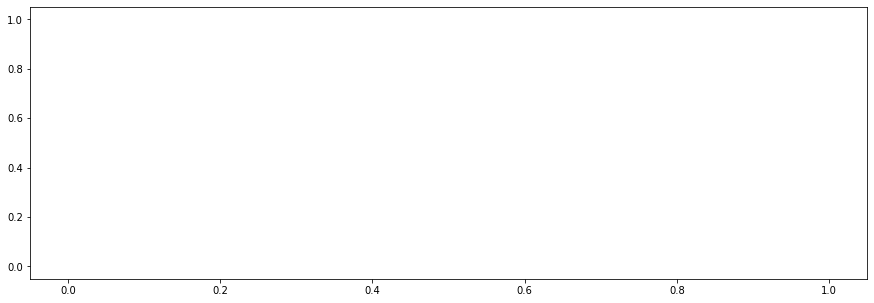

In [208]:
# Show descriptions chart
_describe_lineplot(
    df_inter[COLUMNS],
    describe_m,
    ["média", "mediana"]
)

---

## 8 - Boxplot and Probability density function

__plot_distributions__
- dataset: dataframe with dataset

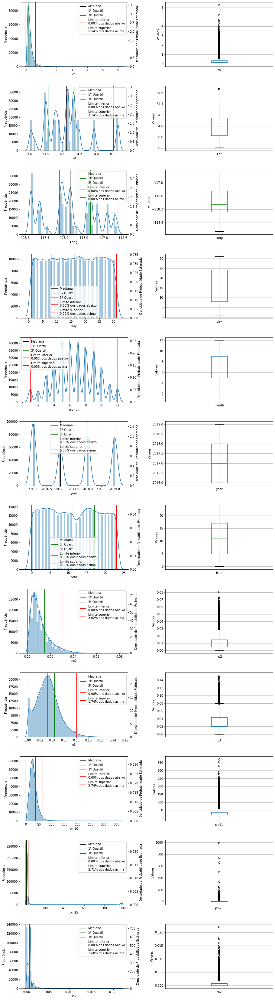

In [209]:
# Plot distributions charts
plot_distributions(df_inter[COLUMNS])

---

## 9 - Autocorrelate

__acfplot__
- df: dataframe of dataset
- lags: lag size

In [ ]:
# Plot acf autocorrelate
_acfplot(df_inter[COLUMNS])

__pacfplot__
- df: dataframe of dataset
- lags: lag size

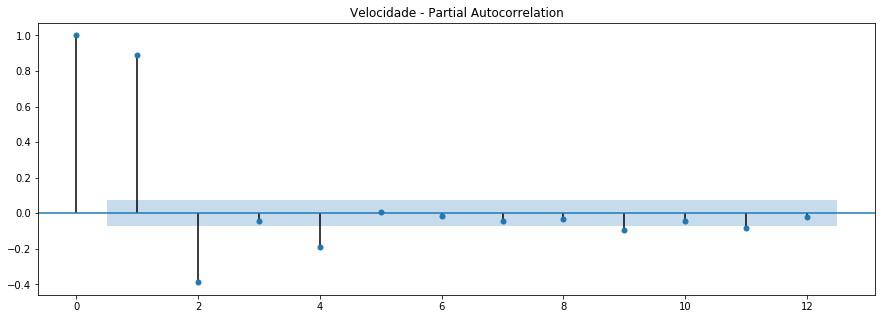

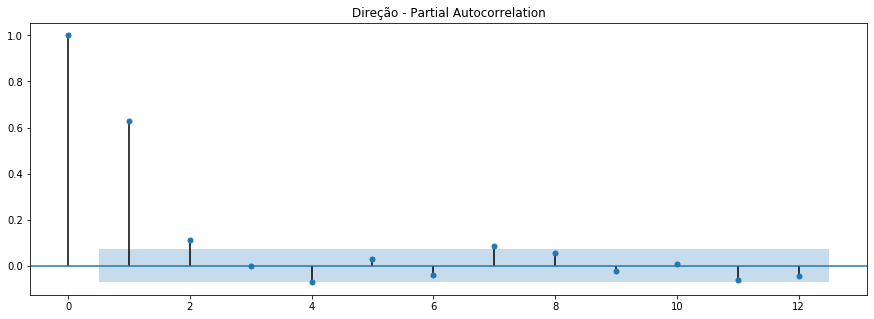

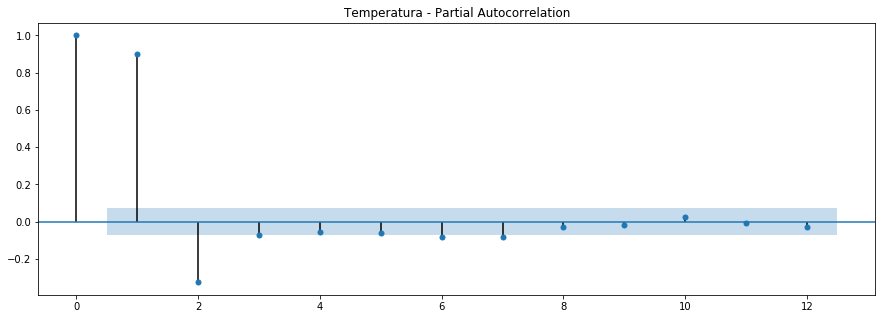

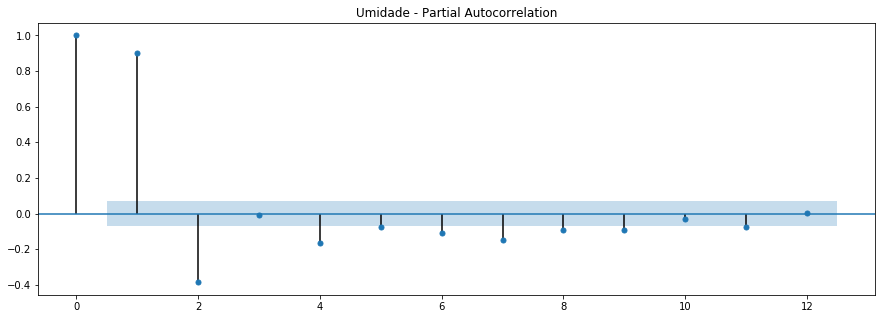

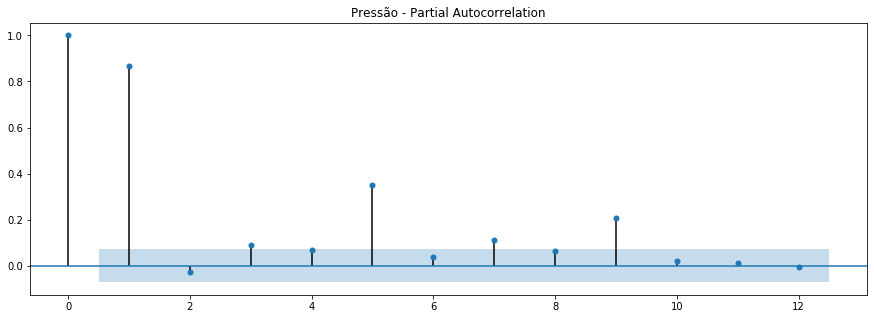

In [35]:
# Plot pacf autocorrelate
_pacfplot(df_inter[COLUMNS])

---

## 10 - Correlate

__corrplot__
- df: dataframe of dataset

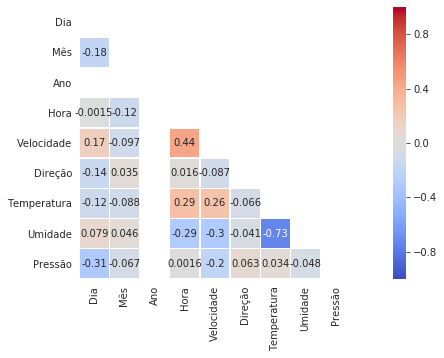

In [36]:
# Show correlation matrix    
_corrplot(df_inter)

---

## 11 - Stationarity test

__rollplot__
- df: dataframe of dataset
- xlabel: name of x axis

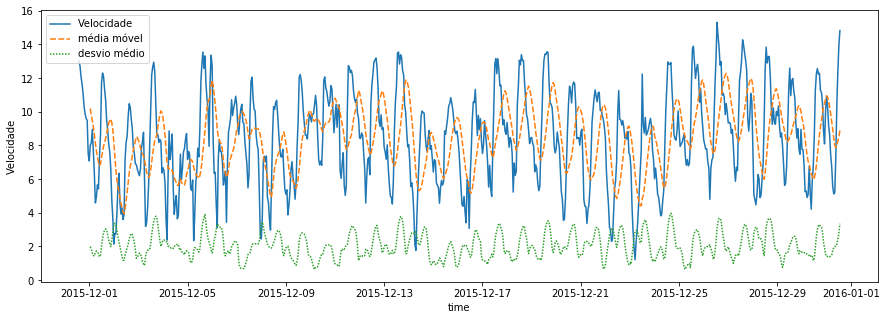

Results of Dickey-Fuller Test:
Test Statistic                  -3.087300
p-value                          0.027507
#Lags Used                      20.000000
Number of Observations Used    723.000000
Critical Value (1%)             -3.439427
Critical Value (5%)             -2.865546
Critical Value (10%)            -2.568903
dtype: float64


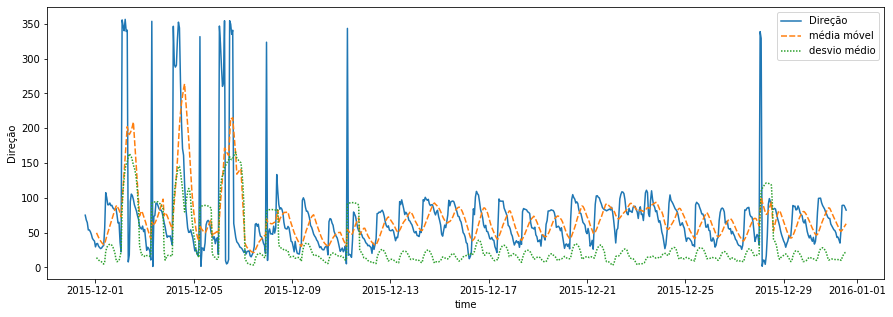

Results of Dickey-Fuller Test:
Test Statistic                -7.008247e+00
p-value                        7.030321e-10
#Lags Used                     7.000000e+00
Number of Observations Used    7.360000e+02
Critical Value (1%)           -3.439266e+00
Critical Value (5%)           -2.865475e+00
Critical Value (10%)          -2.568865e+00
dtype: float64


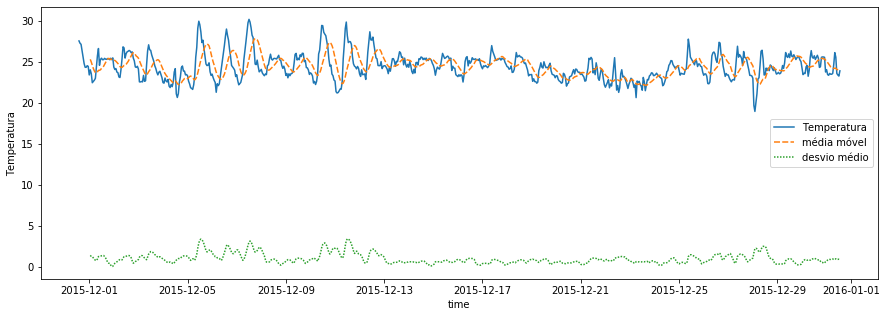

Results of Dickey-Fuller Test:
Test Statistic                  -2.955899
p-value                          0.039223
#Lags Used                      20.000000
Number of Observations Used    723.000000
Critical Value (1%)             -3.439427
Critical Value (5%)             -2.865546
Critical Value (10%)            -2.568903
dtype: float64


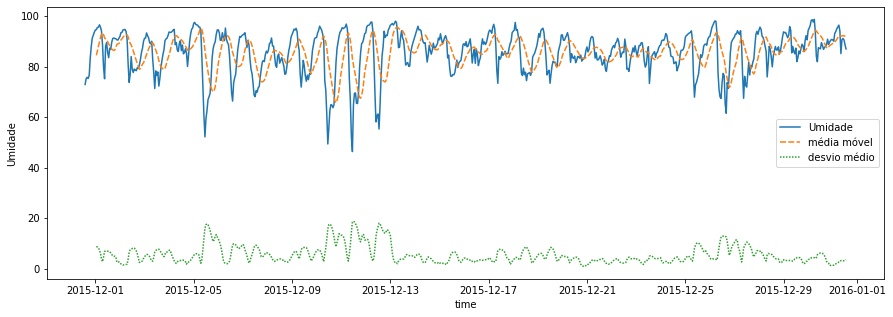

Results of Dickey-Fuller Test:
Test Statistic                  -3.947483
p-value                          0.001712
#Lags Used                      20.000000
Number of Observations Used    723.000000
Critical Value (1%)             -3.439427
Critical Value (5%)             -2.865546
Critical Value (10%)            -2.568903
dtype: float64


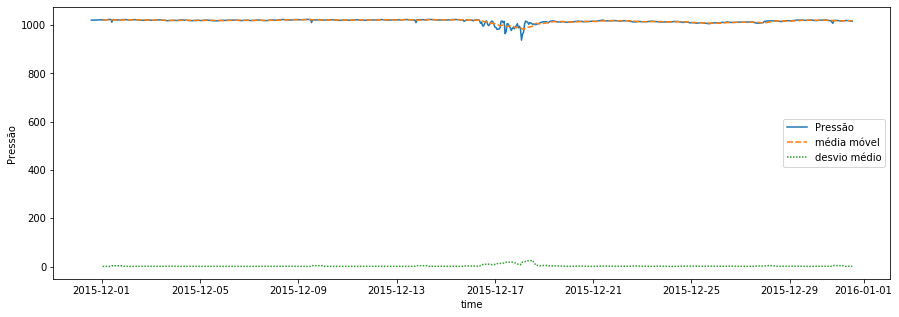

Results of Dickey-Fuller Test:
Test Statistic                  -2.592028
p-value                          0.094656
#Lags Used                      20.000000
Number of Observations Used    723.000000
Critical Value (1%)             -3.439427
Critical Value (5%)             -2.865546
Critical Value (10%)            -2.568903
dtype: float64


In [37]:
# Plot evolution with moving (mean, std) and adftest
_rollplot(df_inter[COLUMNS])

__roll__
- df: pd.DataFrame (dataframe of dataset)
- window: int (window size)
- roll_type: str = "mean" (roll type, "mean", "var" or "std")
- headers: [str] = None (columns name for rolling, if None roll all columns)

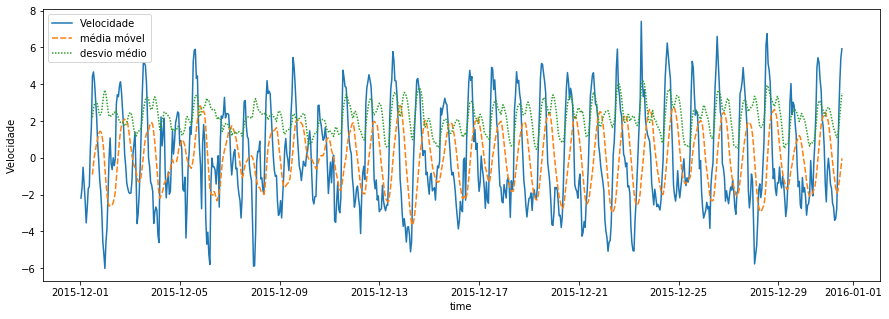

Results of Dickey-Fuller Test:
Test Statistic                -7.552953e+00
p-value                        3.153381e-11
#Lags Used                     2.000000e+01
Number of Observations Used    7.120000e+02
Critical Value (1%)           -3.439568e+00
Critical Value (5%)           -2.865608e+00
Critical Value (10%)          -2.568936e+00
dtype: float64


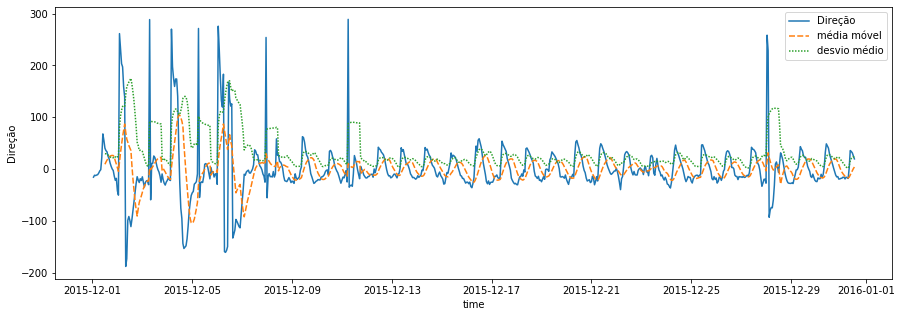

Results of Dickey-Fuller Test:
Test Statistic                -9.595371e+00
p-value                        1.984922e-16
#Lags Used                     1.300000e+01
Number of Observations Used    7.190000e+02
Critical Value (1%)           -3.439478e+00
Critical Value (5%)           -2.865568e+00
Critical Value (10%)          -2.568915e+00
dtype: float64


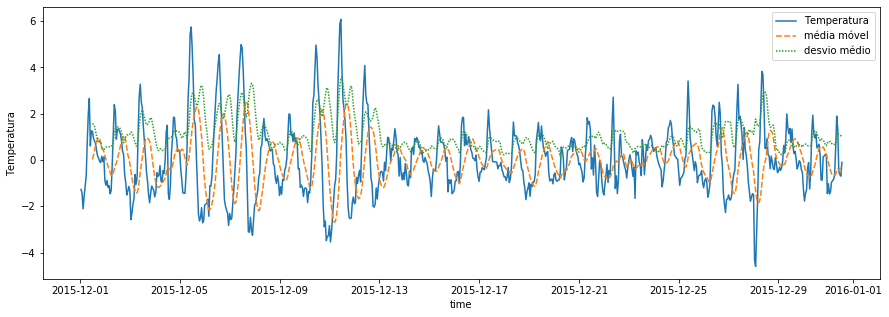

Results of Dickey-Fuller Test:
Test Statistic                -7.508138e+00
p-value                        4.082664e-11
#Lags Used                     2.000000e+01
Number of Observations Used    7.120000e+02
Critical Value (1%)           -3.439568e+00
Critical Value (5%)           -2.865608e+00
Critical Value (10%)          -2.568936e+00
dtype: float64


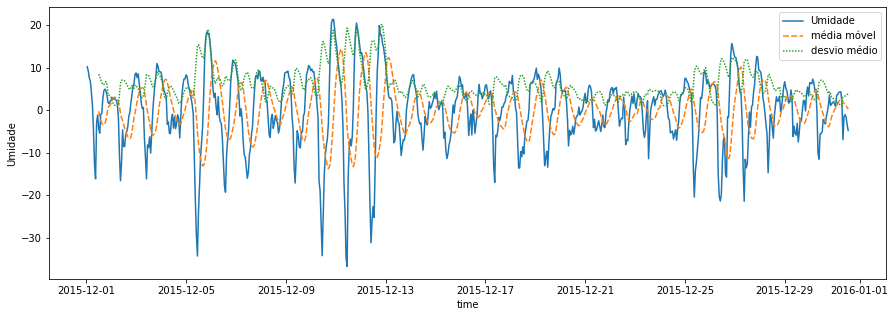

Results of Dickey-Fuller Test:
Test Statistic                -1.242121e+01
p-value                        4.133172e-23
#Lags Used                     1.700000e+01
Number of Observations Used    7.150000e+02
Critical Value (1%)           -3.439529e+00
Critical Value (5%)           -2.865591e+00
Critical Value (10%)          -2.568927e+00
dtype: float64


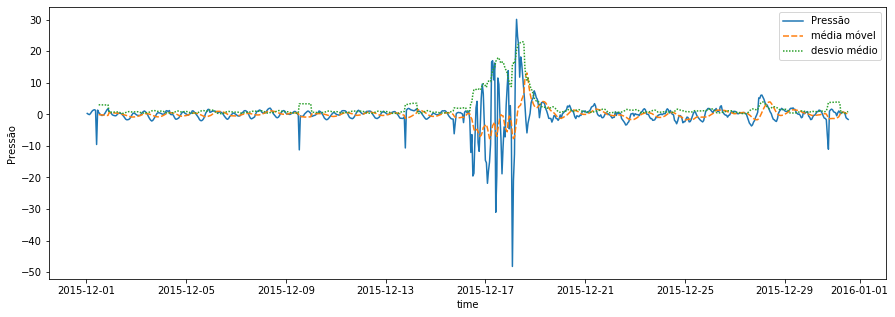

Results of Dickey-Fuller Test:
Test Statistic                  -4.848581
p-value                          0.000044
#Lags Used                      20.000000
Number of Observations Used    712.000000
Critical Value (1%)             -3.439568
Critical Value (5%)             -2.865608
Critical Value (10%)            -2.568936
dtype: float64


In [38]:
# Plot evolution with moving (mean, std) and adftest
# (Decomposed with moving mean)
rolls = roll(df_inter[COLUMNS], 12)
df_normalize = pd.concat(
    [df_inter[[_]] - rolls[[_]] for _ in df_inter[COLUMNS]],
    axis=1,
)
_rollplot(df_normalize.dropna())

__ewm__
- df: pd.DataFrame (dataframe of dataset)
- com: float = None
- span: float = None
- halflife: float = None
- alpha: float = None
- ignore_na: bool = False
- ewm_type: str = 'mean' (exponential weighted type, "mean", "var" or "std")
- headers: [str] = None (columns name for exponential weighted, if None is ew in all columns)

more in [pandas ewm](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.ewm.html)

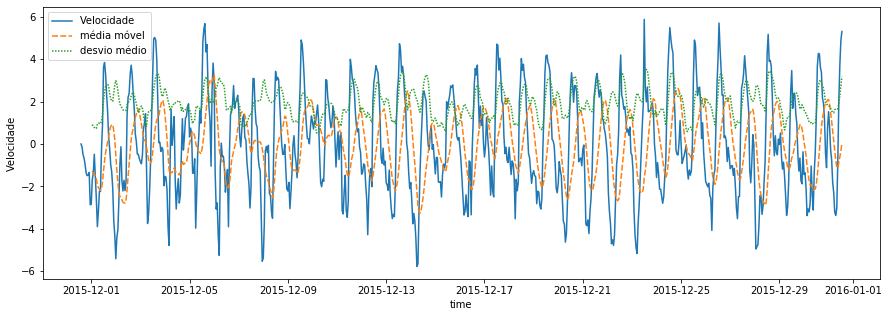

Results of Dickey-Fuller Test:
Test Statistic                -5.663875e+00
p-value                        9.246691e-07
#Lags Used                     2.000000e+01
Number of Observations Used    7.230000e+02
Critical Value (1%)           -3.439427e+00
Critical Value (5%)           -2.865546e+00
Critical Value (10%)          -2.568903e+00
dtype: float64


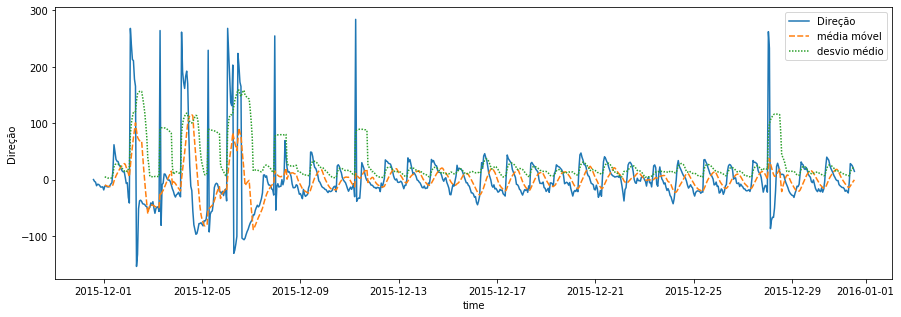

Results of Dickey-Fuller Test:
Test Statistic                -9.189934e+00
p-value                        2.136853e-15
#Lags Used                     6.000000e+00
Number of Observations Used    7.370000e+02
Critical Value (1%)           -3.439254e+00
Critical Value (5%)           -2.865470e+00
Critical Value (10%)          -2.568863e+00
dtype: float64


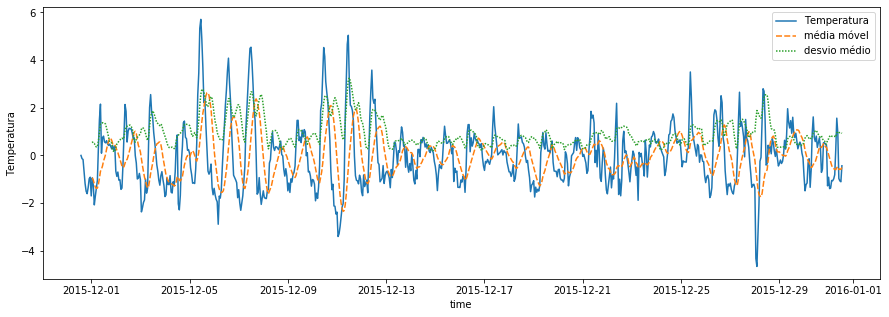

Results of Dickey-Fuller Test:
Test Statistic                -5.729319e+00
p-value                        6.656921e-07
#Lags Used                     2.000000e+01
Number of Observations Used    7.230000e+02
Critical Value (1%)           -3.439427e+00
Critical Value (5%)           -2.865546e+00
Critical Value (10%)          -2.568903e+00
dtype: float64


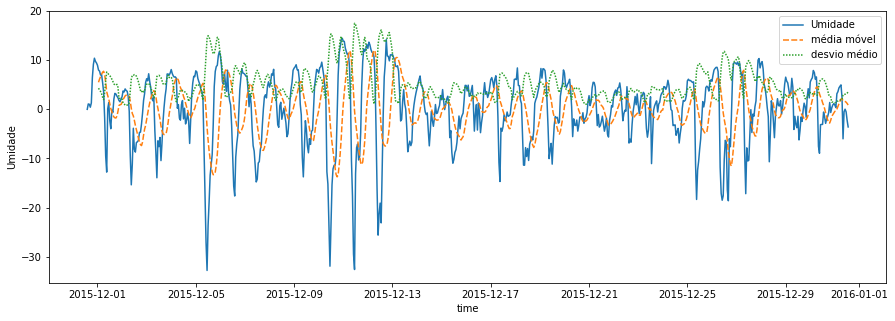

Results of Dickey-Fuller Test:
Test Statistic                -6.921496e+00
p-value                        1.143394e-09
#Lags Used                     2.000000e+01
Number of Observations Used    7.230000e+02
Critical Value (1%)           -3.439427e+00
Critical Value (5%)           -2.865546e+00
Critical Value (10%)          -2.568903e+00
dtype: float64


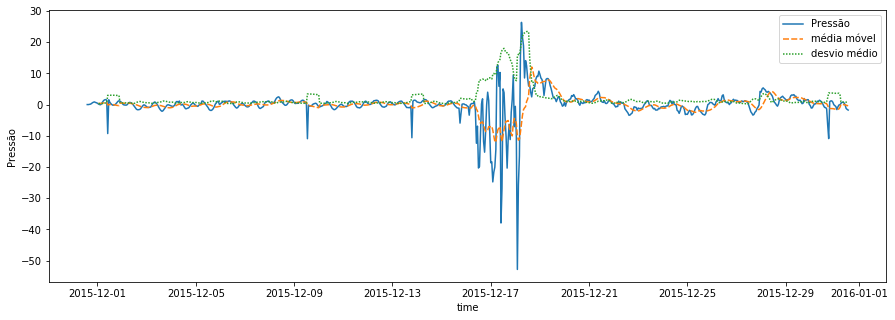

Results of Dickey-Fuller Test:
Test Statistic                  -4.001252
p-value                          0.001404
#Lags Used                      20.000000
Number of Observations Used    723.000000
Critical Value (1%)             -3.439427
Critical Value (5%)             -2.865546
Critical Value (10%)            -2.568903
dtype: float64


In [39]:
# Plot evolution with moving (mean, std) and adftest
# (Decomposed with moving mean exponential weighted)
ewms = ewm(df_inter[COLUMNS], 12)
df_normalize = pd.concat(
    [df_inter[[_]] - ewms[[_]] for _ in df_inter[COLUMNS]],
    axis=1,
)
_rollplot(df_normalize.dropna())

---

## 12 - Decompositions

### 12.1 - Seasonal

__seasonalplot__
- df: dataframe of dataset
- model: Type of seasonal component - “additive” or “multiplicative”

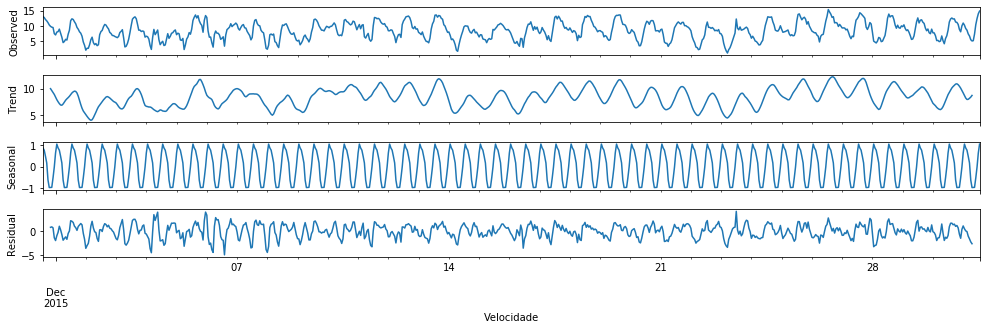

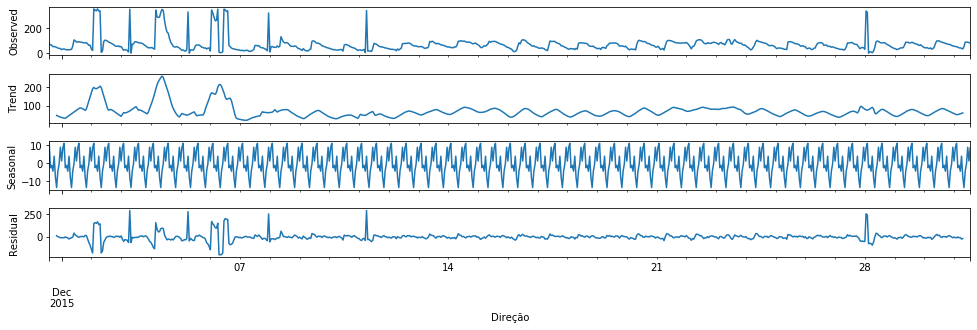

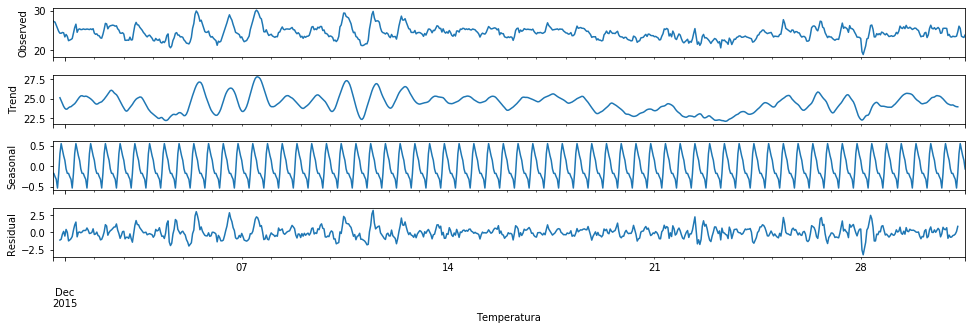

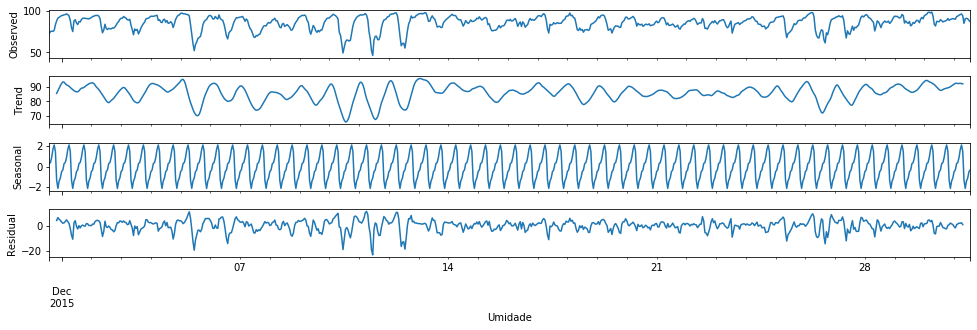

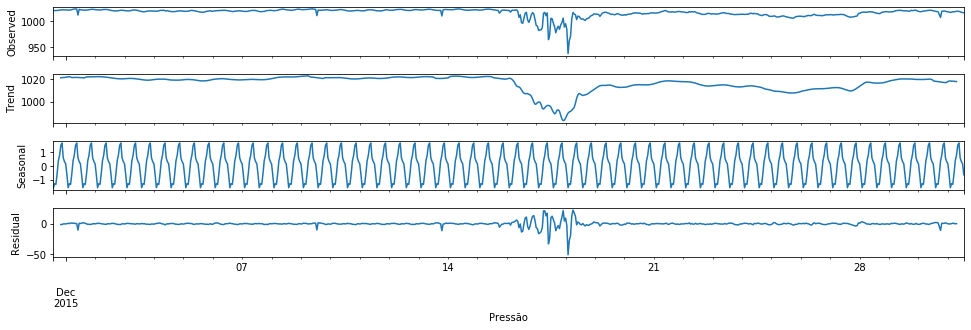

In [40]:
# Plot seasonal decompose
_seasonalplot(df_inter[COLUMNS])

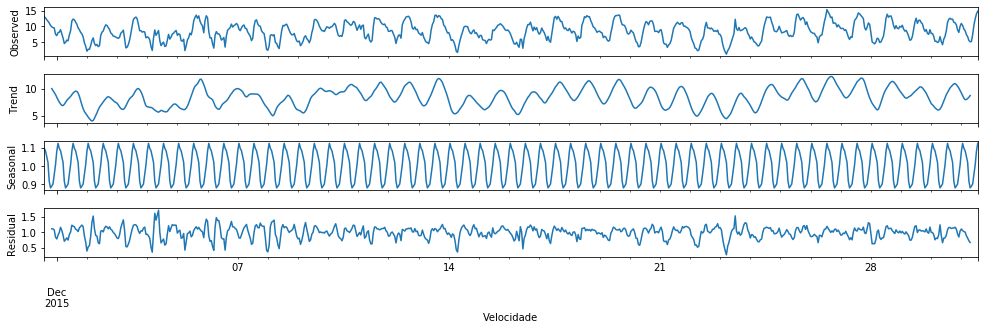

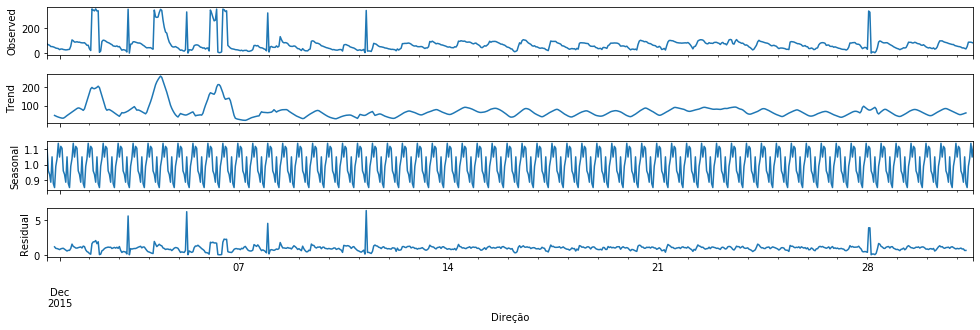

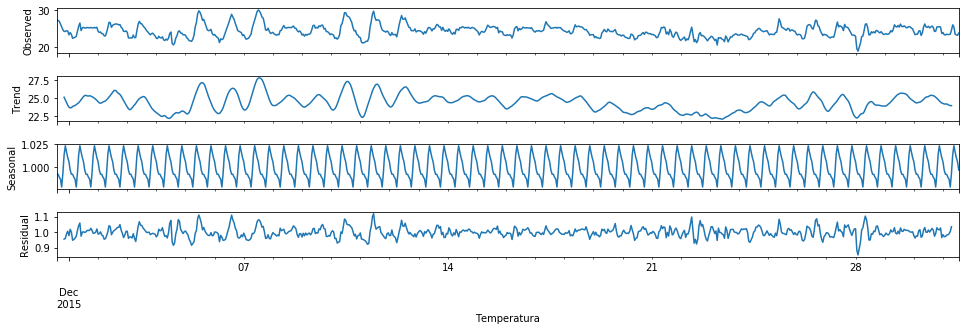

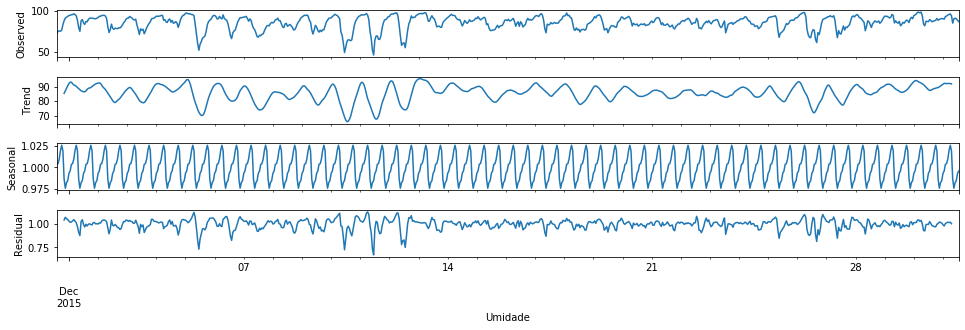

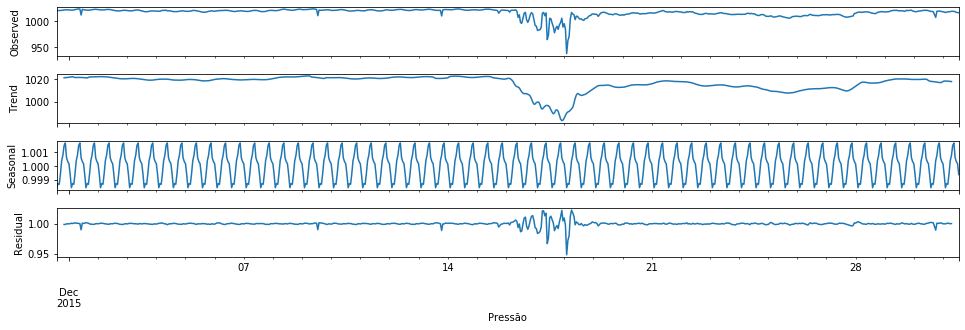

In [41]:
# Plot seasonal decompose
_seasonalplot(df_inter[COLUMNS], model='multiplicative')

---

### 12.2 - SSA (Singular Spectrum Analysis)

- data_frame: pd.DataFrame
- window_size: int or float = 4
- groups: int or [int] = None
- headers: [str] = None

more in [pyts SSA](https://pyts.readthedocs.io/en/latest/generated/pyts.decomposition.SingularSpectrumAnalysis.html)

In [42]:
# SSA (window default: 4)
decompose_ssa = ssa(df_inter[COLUMNS])
decompose_ssa

,Velocidade,Direção,Temperatura,Umidade,Pressão
0,"[12.309849298738941, 12.120617371649374, 11.85...","[64.17286732137917, 62.79911893120935, 60.8840...","[27.04613493047644, 26.790851296686103, 26.497...","[74.74299240142706, 75.23877426940993, 76.0865...","[1020.4900000441978, 1020.5447700436143, 1020...."
1,"[0.7027478288897004, 0.539647907528352, 0.2991...","[9.620658701716998, 6.141880812863728, 1.59000...","[0.5342635914242599, 0.5543836281347909, 0.429...","[-1.0843272691560344, -0.46834137493843464, -1...","[-0.10664260275524384, -0.1353674099074027, -0..."
2,"[0.01520798109322996, 0.02543869970979995, -0....","[0.2738475217923586, 0.9506043518709806, 0.252...","[-0.12639331819897404, -0.023385640624949744, ...","[-0.6500526329195466, 0.4352574419390933, 0.75...","[0.03463213606207205, 0.0013245525515230838, 0..."
3,"[-0.015666358721867724, 0.04038298111247396, -...","[1.0381074451115104, -1.5572718159440213, 1.73...","[0.062123826298276175, -0.08375404419593235, 0...","[-0.07797665935151521, 0.006430873589410524, -...","[0.00461142249524471, -0.016379186258724587, 0..."


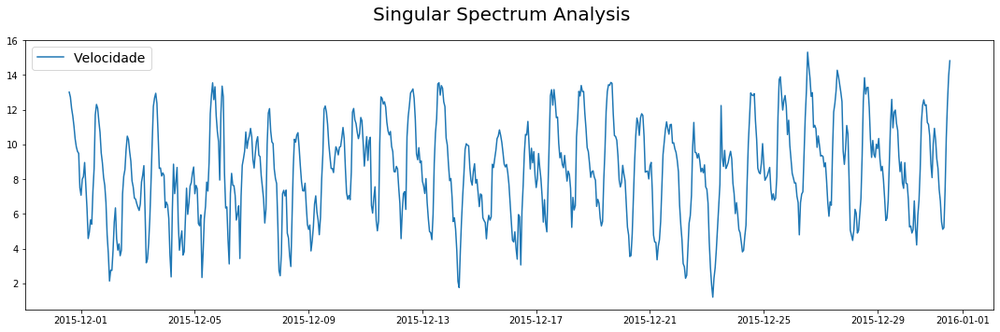

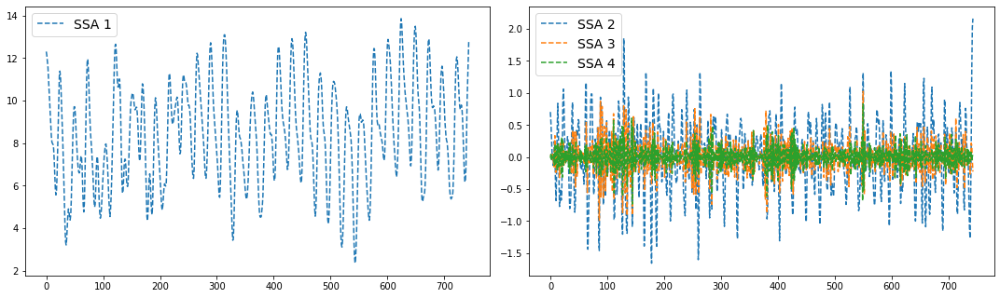

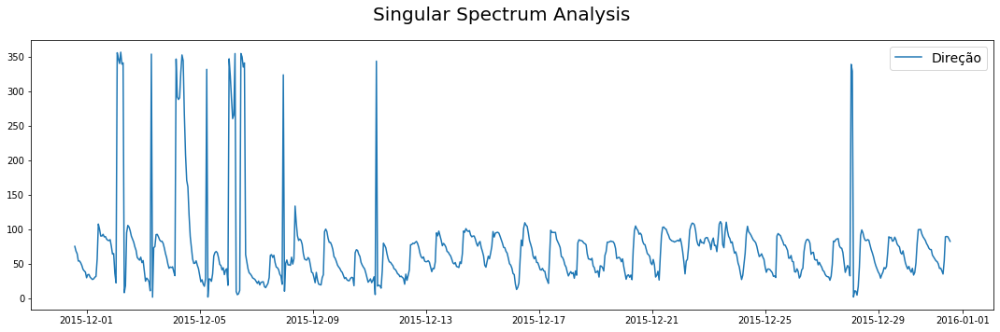

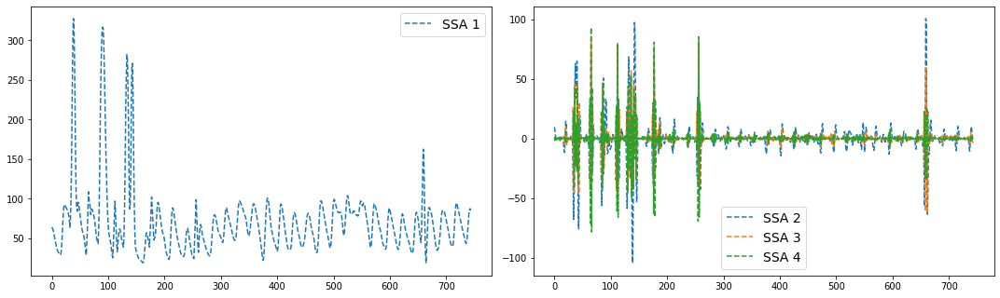

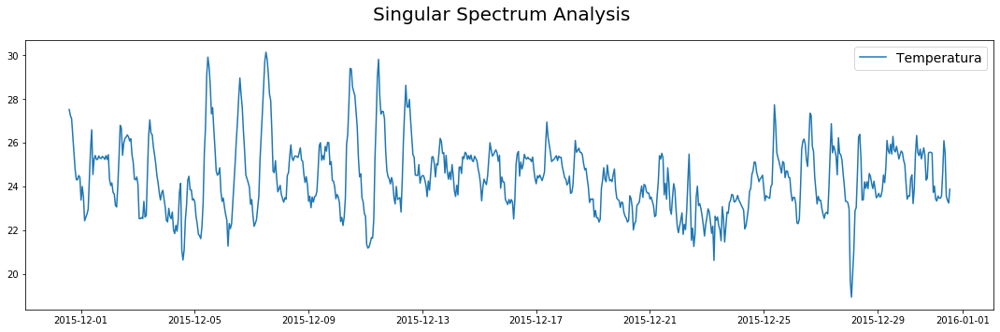

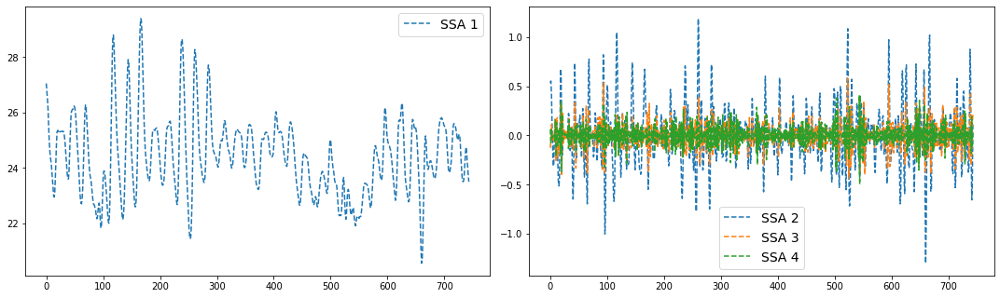

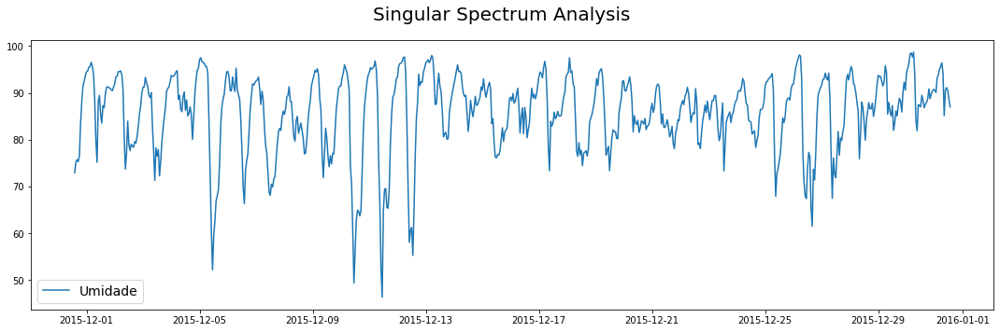

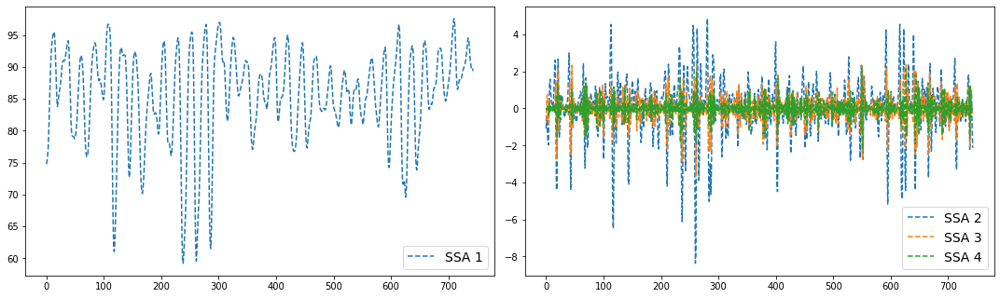

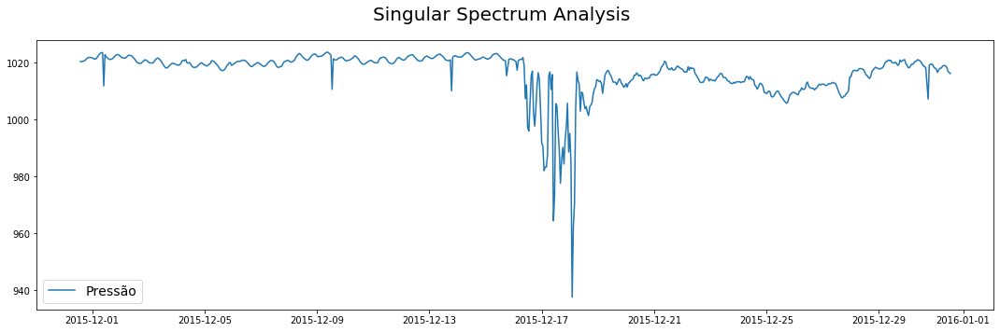

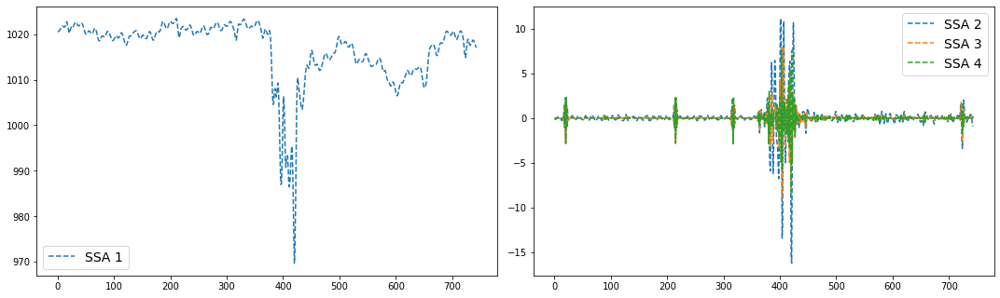

In [43]:
# Ploting results
_ssaplot(df_inter[COLUMNS], decompose_ssa)

---

## 13 - Regressions

#### pre-processing

In [44]:
# Time step for use in all models
TIME_STEP = 24

# Define column name to regressors and predictors
REGRESSORS = df_inter.columns
PREDICTORS = "Velocidade"

### 13.1 - Generalized Linear

__GeneralizedLinear__
- df_true: pd.DataFrame (input dataframe for 'train')
- df_pred: pd.DataFrame = None (input dataframe for forecasting)
- fit_intercept: bool = True
- normalize: bool = False
- time_step: int = 1
- linear_type: str = "LinearRegression"
  - __'MultiTaskElasticNetCV'__
  - __'ElasticNetCV'__
  - __'RidgeCV'__
  - __'LassoCV'__
  - __'LinearRegression'__
- regressors: [str] = None
- predictors: [str] = None

more in [scikit Linear](https://scikit-learn.org/stable/modules/linear_model.html)

---

#### LinearRegression

In [45]:
# Linear Regression
regress = GeneralizedLinear(
    df_inter,
    regressors=REGRESSORS,
    predictors=[PREDICTORS],
    time_step=TIME_STEP,
    linear_type="LinearRegression"
).run()

regress

,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
0,12.735364,12.327911,11.876310,11.379773,10.677430,9.898213,9.190449,8.596927,8.153675,7.900794,...,6.495458,6.495626,6.821515,7.228038,7.856836,8.704755,9.378650,9.881324,9.826942,9.511722
1,12.357064,11.892175,11.414684,10.931110,10.279168,9.562510,8.885487,8.319851,7.892105,7.654878,...,6.818693,6.927719,7.319093,7.741536,8.316918,9.058449,9.613936,9.980016,9.790394,9.352275
2,11.759044,11.414829,11.060485,10.702465,10.157182,9.505279,8.826578,8.229909,7.753090,7.467163,...,7.002381,7.194739,7.629366,8.051435,8.560554,9.190308,9.618306,9.849493,9.564616,9.079327
3,11.252852,10.927272,10.605210,10.284558,9.800732,9.211885,8.555413,7.965697,7.476174,7.164279,...,6.972680,7.260732,7.770123,8.253292,8.780497,9.351568,9.686387,9.811428,9.443950,8.878237
4,10.590543,10.254998,9.937647,9.655591,9.243825,8.740713,8.128360,7.571110,7.098830,6.793136,...,7.106212,7.508342,8.092963,8.614421,9.108154,9.569395,9.779231,9.777347,9.299228,8.626802
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
739,7.862876,8.346429,8.831486,9.330672,9.643136,9.822152,9.879009,9.844250,9.865126,9.896442,...,9.986658,9.778808,9.492828,9.117203,8.700540,8.421628,8.203400,8.068834,8.004367,8.103441
740,10.121770,9.603902,9.137119,8.774909,8.499231,8.418589,8.451324,8.552920,8.769302,8.981769,...,9.108927,9.040985,8.994064,8.978166,9.033715,9.169143,9.362825,9.614803,9.705946,9.631561
741,11.806855,10.810157,9.864818,9.038003,8.401205,8.094160,8.021235,8.102373,8.331928,8.571271,...,8.600909,8.603935,8.690539,8.872126,9.197457,9.610070,10.087831,10.599211,10.827597,10.735959
742,13.145449,11.835850,10.568955,9.406773,8.488892,7.985068,7.792632,7.808414,8.001254,8.213843,...,8.024859,8.080884,8.277062,8.631139,9.198172,9.857417,10.574985,11.307780,11.674687,11.606222


#### LinearRegression - evaluate

In [46]:
# Evaluate forecasting
LR_eval = _mult_regress_evaluate(df_inter[PREDICTORS], regress, "LinearRegression")
LR_eval

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (1-Hour),0.830054,0.993271,0.911073,0.881288,1.284549,0.003731,4.965890
LinearRegression (2-Hour),0.634598,0.979784,0.796616,1.296533,2.756552,0.001080,5.915851
LinearRegression (3-Hour),0.507280,0.970310,0.712236,1.519317,3.713156,0.001569,5.871901
LinearRegression (4-Hour),0.413900,0.963513,0.643351,1.673591,4.414596,0.002106,6.999532
LinearRegression (5-Hour),0.332493,0.956698,0.576622,1.779010,5.028243,0.000785,7.012025
LinearRegression (6-Hour),0.254597,0.949865,0.504576,1.865185,5.618947,0.005466,6.623448
LinearRegression (7-Hour),0.216054,0.943012,0.464816,1.894650,5.915268,0.000484,6.990367
LinearRegression (8-Hour),0.229598,0.945652,0.479164,1.868536,5.819492,0.002210,6.884476
LinearRegression (9-Hour),0.302296,0.952381,0.549814,1.787679,5.276409,0.001910,8.014172
LinearRegression (10-Hour),0.414426,0.961853,0.643760,1.636854,4.433794,0.001055,7.664407


#### LinearRegression - chart

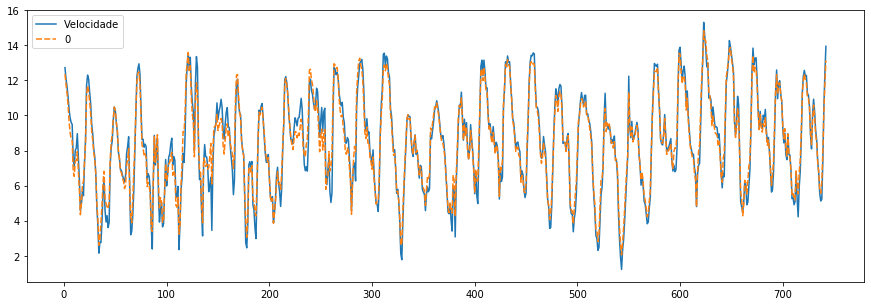

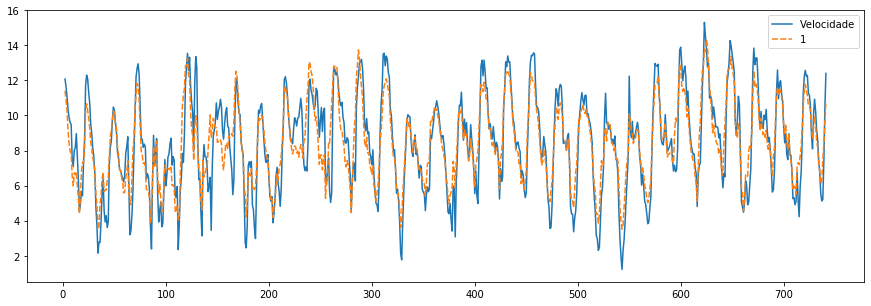

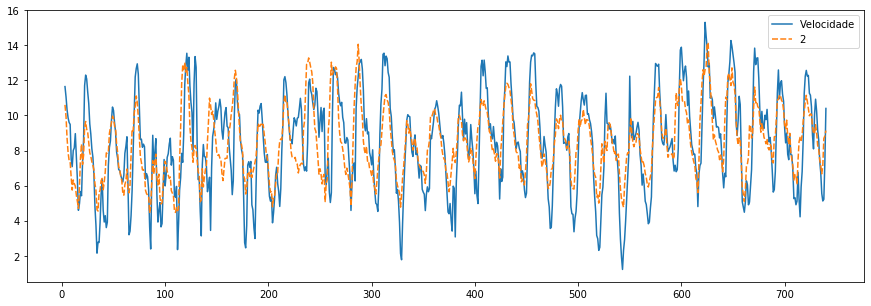

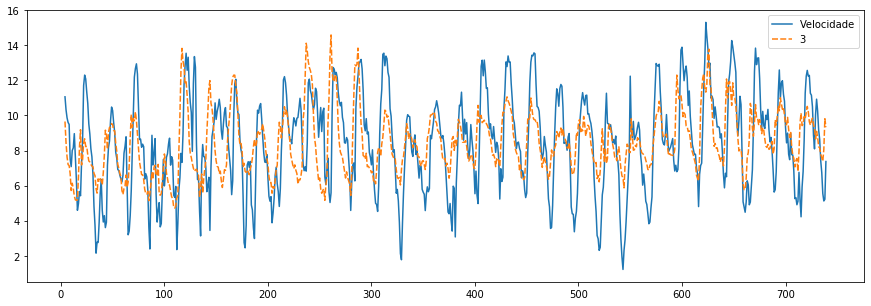

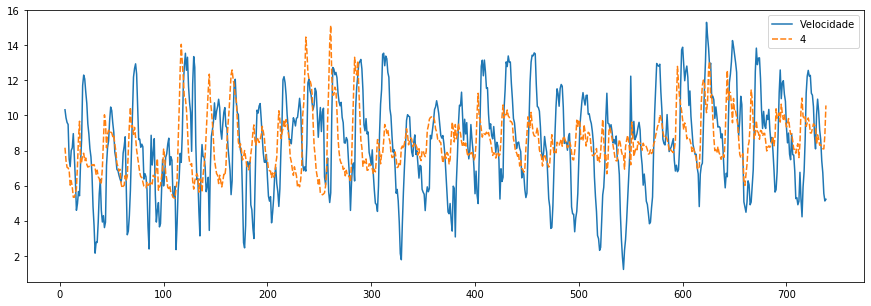

...

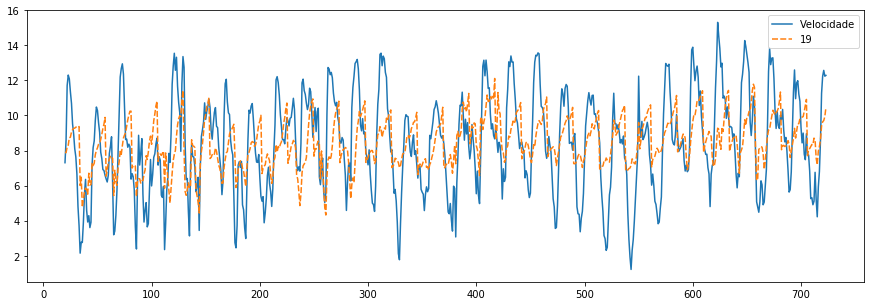

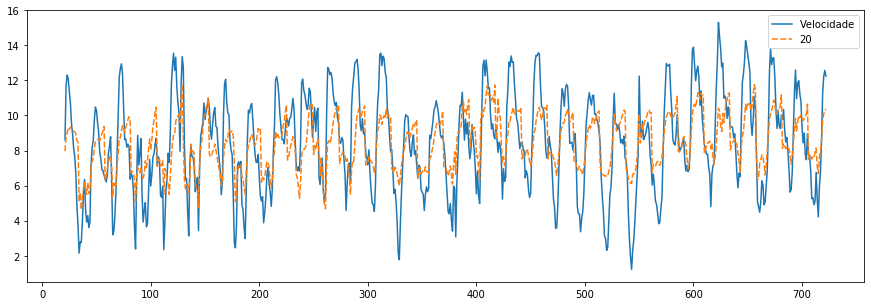

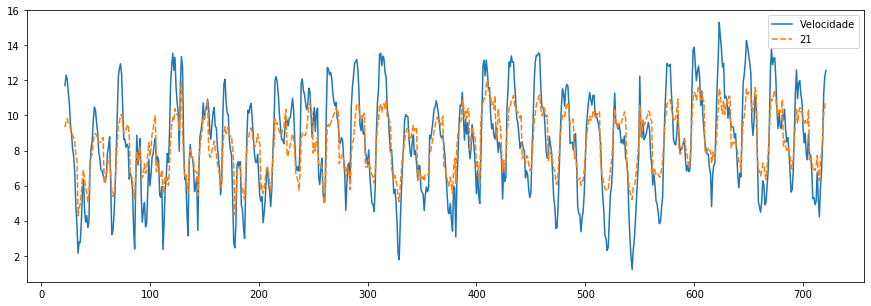

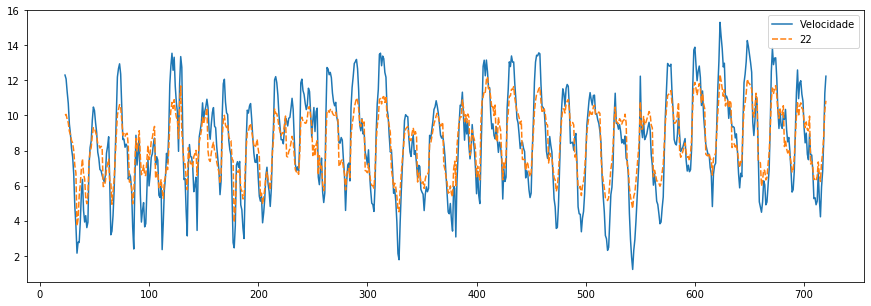

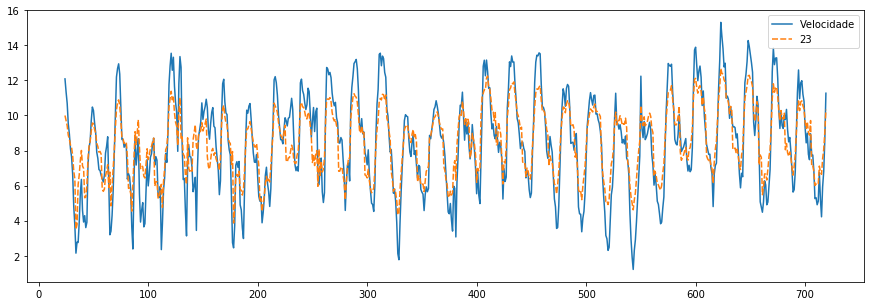

In [47]:
# Plot linear regression result
_regressplot(df_inter[PREDICTORS].reset_index(drop=True), regress)

---

#### RidgeCV

In [48]:
# RidgeCV
regress = GeneralizedLinear(
    df_inter,
    regressors=REGRESSORS,
    predictors=[PREDICTORS],
    time_step=TIME_STEP,
    linear_type="RidgeCV"
).run()

regress

/opt/anaconda3/envs/accept-data-analysis/lib/python3.6/site-packages/sklearn/model_selection/_search.py:814: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
/opt/anaconda3/envs/accept-data-analysis/lib/python3.6/site-packages/sklearn/model_selection/_search.py:814: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
/opt/anaconda3/envs/accept-data-analysis/lib/python3.6/site-packages/sklearn/model_selection/_search.py:814: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)
/opt/anaconda3/e

,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
0,13.048359,12.853508,12.559692,12.114510,11.411887,10.622488,9.876708,9.189777,8.670465,8.293120,...,6.617317,6.558793,6.758565,7.097508,7.700633,8.550372,9.309941,9.994557,9.828006,9.513746
1,12.670515,12.417925,12.097958,11.665547,11.013189,10.286280,9.571228,8.912251,8.408535,8.046979,...,6.940242,6.990558,7.255912,7.610880,8.160723,8.904204,9.545409,10.093373,9.791456,9.354297
2,12.074300,11.942087,11.744981,11.437808,10.891810,10.229414,9.512561,8.822499,8.269727,7.859504,...,7.123695,7.257234,7.565794,7.920424,8.404164,9.036135,9.550168,9.963582,9.565680,9.081351
3,11.573443,11.462477,11.299752,11.030976,10.546642,9.946854,9.251372,8.566773,8.000025,7.562334,...,7.096505,7.324825,7.706546,8.121028,8.622047,9.195409,9.617321,9.926606,9.445026,8.880284
4,10.915544,10.796549,10.640069,10.410588,9.998389,9.483957,8.831922,8.178650,7.628184,7.195562,...,7.231818,7.573495,8.029231,8.481088,8.948089,9.411741,9.709523,9.893447,9.300312,8.628867
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
739,7.834398,8.296565,8.764905,9.256719,9.567196,9.746893,9.807769,9.782698,9.811826,9.855290,...,9.970534,9.768887,9.495939,9.128766,8.716839,8.438429,8.212146,8.059908,8.004262,8.103233
740,10.094938,9.563293,9.086263,8.721076,8.445796,8.366221,8.401671,8.509847,8.731450,8.952615,...,9.100157,9.036809,8.999593,8.988966,9.046325,9.180884,9.366888,9.603281,9.705855,9.631389
741,11.777002,10.768091,9.813950,8.985460,8.350042,8.044562,7.974380,8.061761,8.296075,8.543643,...,8.593804,8.601301,8.697198,8.883445,9.209785,9.620859,10.090374,10.585699,10.827505,10.735786
742,13.113755,11.793324,10.518909,9.356196,8.440510,7.938558,7.748786,7.770412,7.967527,8.187883,...,8.019406,8.079732,8.284773,8.642889,9.210169,9.867350,10.576293,11.292764,11.674594,11.606049


#### RidgeCV - evaluate

In [49]:
# Evaluate forecasting
R_eval = _mult_regress_evaluate(df_inter[PREDICTORS], regress, "RidgeCV")
R_eval

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
RidgeCV (1-Hour),0.829849,0.993271,0.910960,0.881762,1.286118,0.001788,4.963101
RidgeCV (2-Hour),0.634031,0.979784,0.796261,1.298998,2.760844,0.000264,5.920799
RidgeCV (3-Hour),0.506327,0.971660,0.711567,1.521758,3.720362,0.001607,5.880371
RidgeCV (4-Hour),0.412799,0.963513,0.642494,1.676693,4.422927,0.000101,7.008974
RidgeCV (5-Hour),0.331393,0.956698,0.575668,1.781179,5.036575,0.001033,7.023438
RidgeCV (6-Hour),0.253531,0.949865,0.503519,1.869264,5.627039,0.001544,6.640162
RidgeCV (7-Hour),0.215100,0.941655,0.463788,1.895797,5.922523,0.003038,6.979544
RidgeCV (8-Hour),0.228885,0.945652,0.478419,1.871147,5.824907,0.001594,6.905274
RidgeCV (9-Hour),0.301753,0.952381,0.549321,1.789847,5.280523,0.000277,8.032124
RidgeCV (10-Hour),0.414113,0.961853,0.643516,1.638593,4.436175,0.011750,7.664872


#### RidgeCV - chart

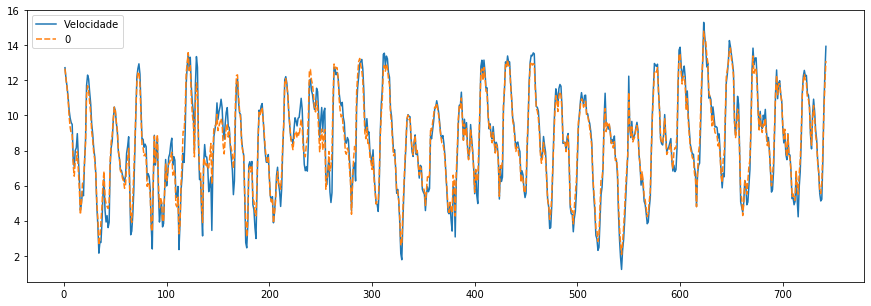

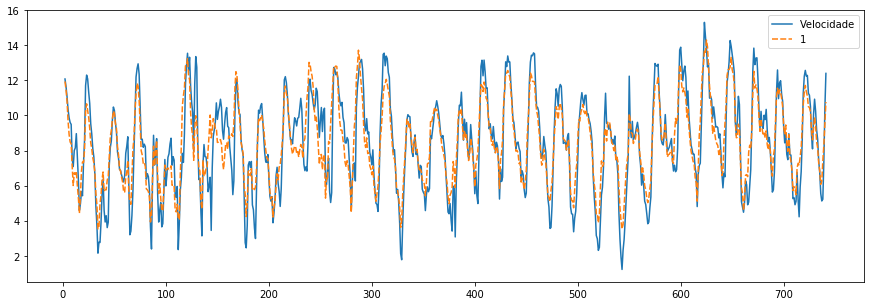

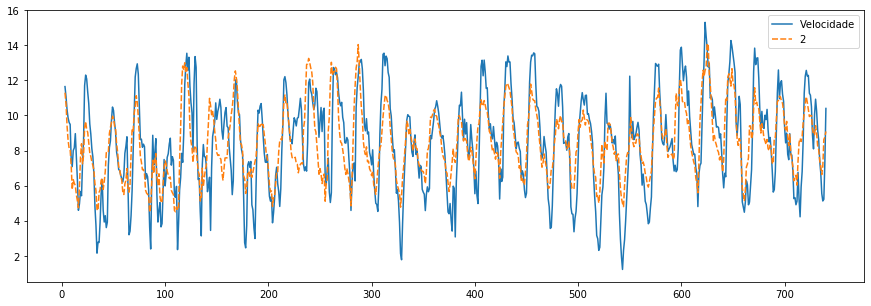

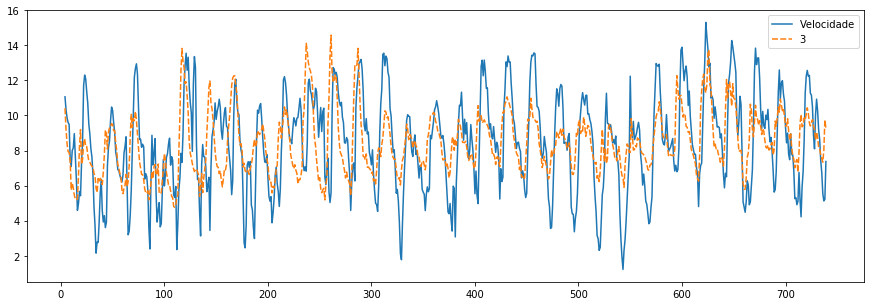

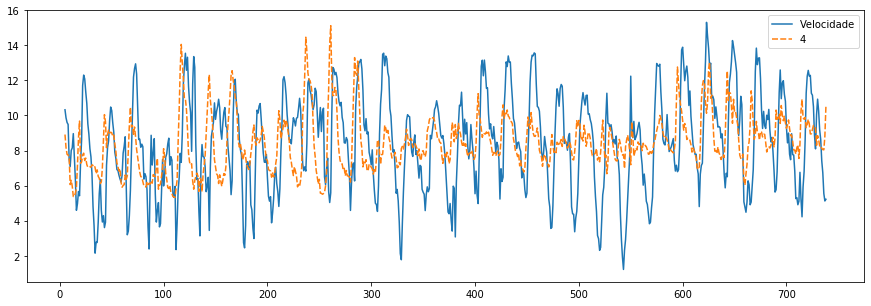

...

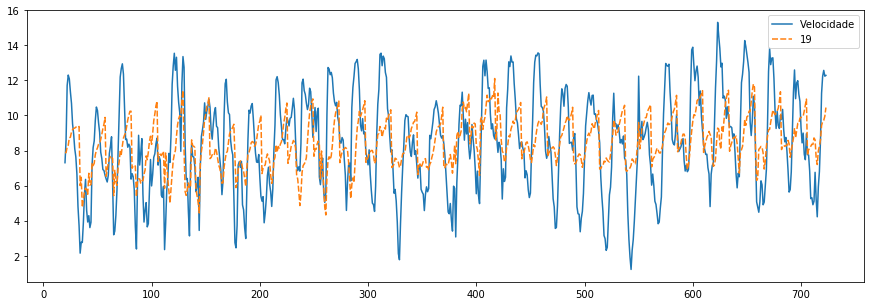

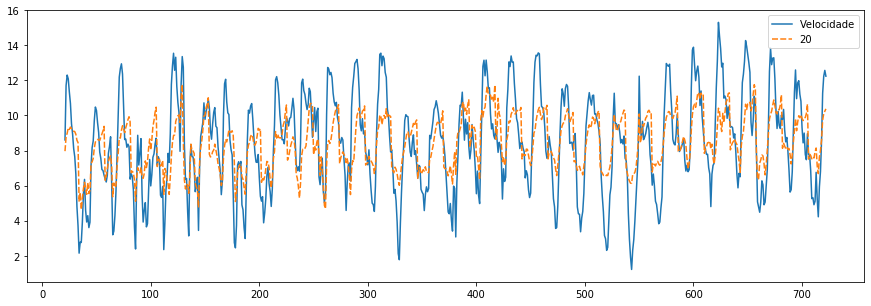

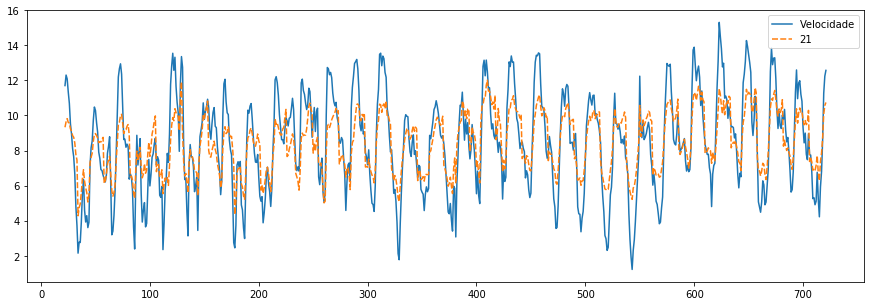

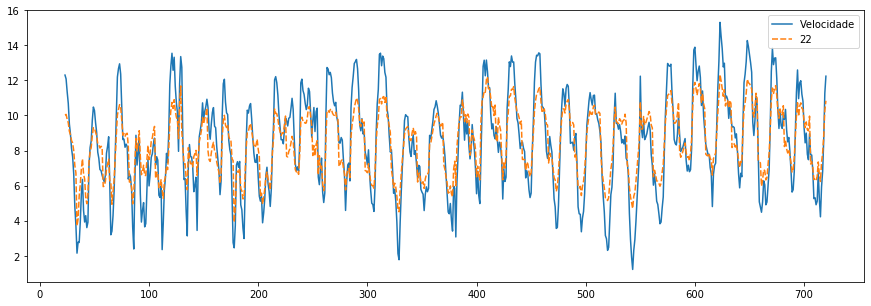

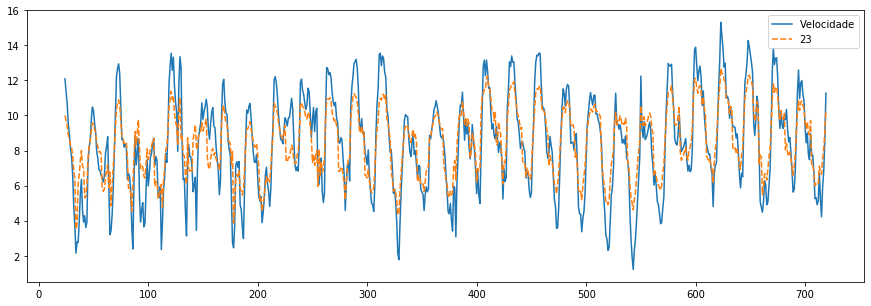

In [50]:
# Plot RidgeCV result
_regressplot(df_inter[PREDICTORS].reset_index(drop=True), regress)

---

#### LassoCV

In [51]:
# RidgeCV
regress = GeneralizedLinear(
    df_inter,
    regressors=REGRESSORS,
    predictors=[PREDICTORS],
    time_step=TIME_STEP,
    linear_type="LassoCV"
).run()

regress

/opt/anaconda3/envs/accept-data-analysis/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:1100: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/anaconda3/envs/accept-data-analysis/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:1100: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/anaconda3/envs/accept-data-analysis/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:1100: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/anaconda3/envs/accept-data-analysis/lib/python3.6/site-packages/sklearn/li

,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
0,13.285775,13.309259,13.134561,12.735379,12.050810,11.262914,10.480147,9.715447,9.083790,8.564714,...,6.663318,7.321260,7.449429,7.581359,7.814314,8.253816,9.047826,9.906609,10.642290,11.261122
1,12.911357,12.874068,12.676370,12.290089,11.652823,10.927004,10.174955,9.438007,8.822860,8.320206,...,6.972404,7.557644,7.664516,7.884935,8.153473,8.529035,9.262543,9.984414,10.599708,11.106470
2,12.320857,12.400158,12.329954,12.069293,11.529617,10.868878,10.115075,9.347414,8.681390,8.128838,...,7.137183,7.627210,7.729157,8.017726,8.331482,8.700132,9.326608,9.913277,10.417008,10.845667
3,11.844852,11.936339,11.910715,11.688259,11.212079,10.605932,9.873928,9.106069,8.451609,7.887843,...,7.210833,7.657889,7.764010,8.109443,8.476647,8.866551,9.405467,9.883175,10.298240,10.665442
4,11.207434,11.282841,11.272594,11.089362,10.685314,10.158489,9.470225,8.729231,8.110931,7.564881,...,7.413201,7.766424,7.860478,8.281607,8.685879,9.045524,9.493805,9.842424,10.148446,10.433364
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
739,7.762230,8.228873,8.671022,9.161303,9.436791,9.642451,9.703932,9.702241,9.652102,9.648858,...,9.574693,8.729466,8.692451,8.726499,8.611624,8.434581,8.311207,8.155990,8.018457,7.940432
740,10.061166,9.523739,9.026437,8.656511,8.407442,8.325680,8.362763,8.474894,8.708201,8.941674,...,9.100545,8.771118,8.729139,8.837905,8.777345,8.598504,8.964785,9.187422,9.352368,9.434601
741,11.744325,10.729834,9.752223,8.917639,8.335093,8.019701,7.951394,8.037666,8.308501,8.584748,...,8.714697,8.724674,8.688080,8.865811,8.878143,8.736112,9.436240,9.915975,10.293637,10.503823
742,13.085922,11.758353,10.459336,9.289351,8.447534,7.928218,7.740671,7.756410,8.014007,8.278848,...,8.260873,8.582289,8.563691,8.787443,8.869957,8.802732,9.753823,10.451950,11.012878,11.346696


#### LassoCV - evaluate

In [52]:
# Evaluate forecasting
L_eval = _mult_regress_evaluate(df_inter[PREDICTORS], regress, "LassoCV")
L_eval

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LassoCV (1-Hour),0.829221,0.993271,0.910616,0.883062,1.290988,0.001100,4.910141
LassoCV (2-Hour),0.632508,0.979784,0.795303,1.302708,2.772402,0.002298,5.929870
LassoCV (3-Hour),0.503729,0.971660,0.709738,1.526450,3.740095,0.002878,5.896717
LassoCV (4-Hour),0.409809,0.963513,0.640163,1.681419,4.445578,0.007039,7.024381
LassoCV (5-Hour),0.328297,0.956698,0.572972,1.786109,5.060197,0.000267,7.052648
LassoCV (6-Hour),0.250636,0.949865,0.500636,1.876242,5.649085,0.000121,6.683700
LassoCV (7-Hour),0.212503,0.943012,0.460981,1.901348,5.942403,0.000245,6.964053
LassoCV (8-Hour),0.226966,0.944293,0.476409,1.876442,5.839515,0.002620,6.911374
LassoCV (9-Hour),0.299908,0.952381,0.547638,1.793711,5.295140,0.005683,8.008669
LassoCV (10-Hour),0.412338,0.960490,0.642135,1.638215,4.450338,0.000894,7.702876


#### LassoCV - chart

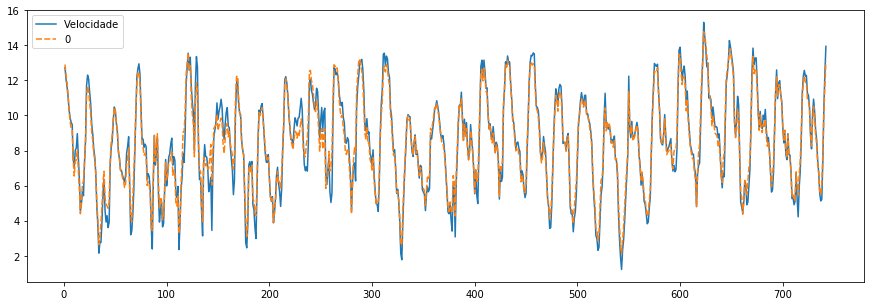

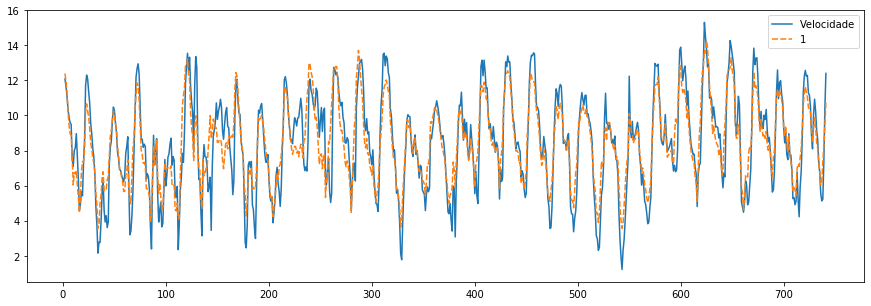

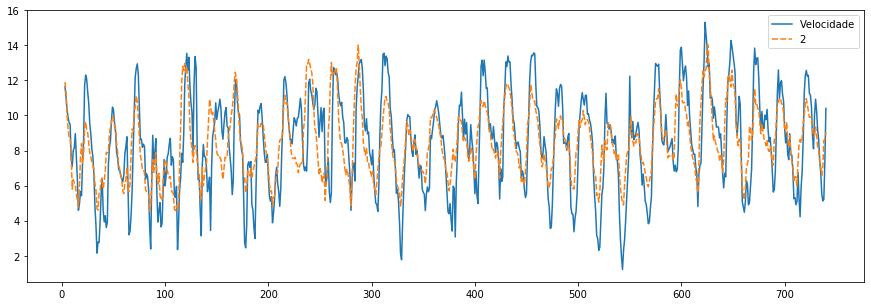

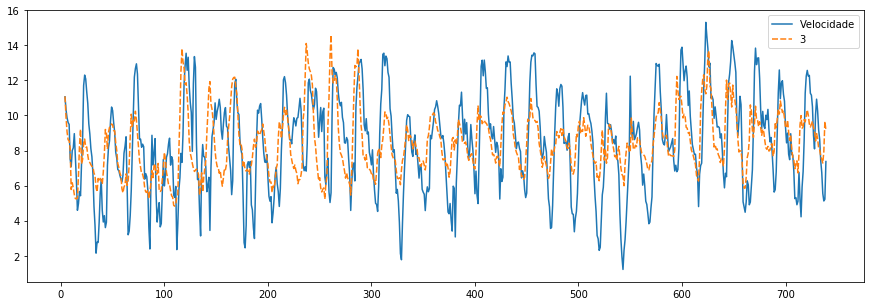

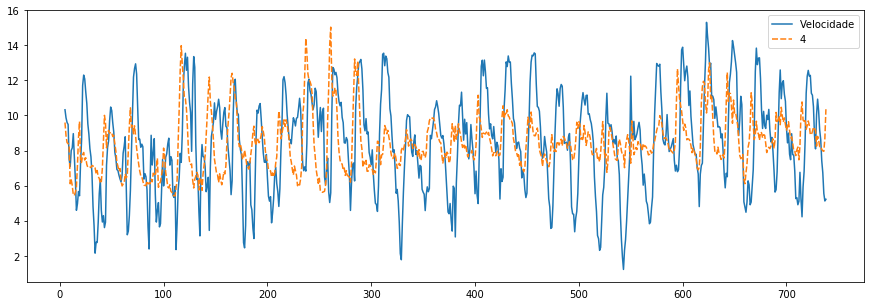

...

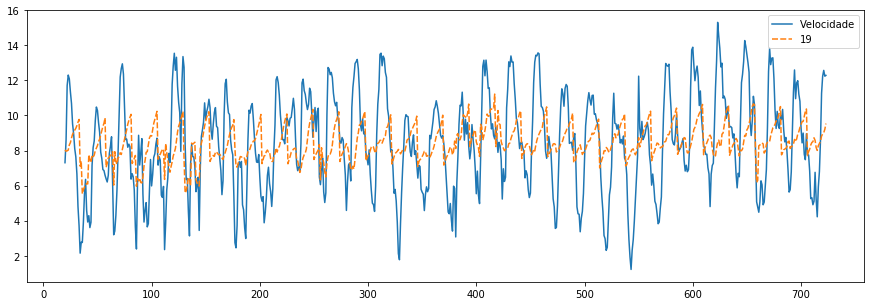

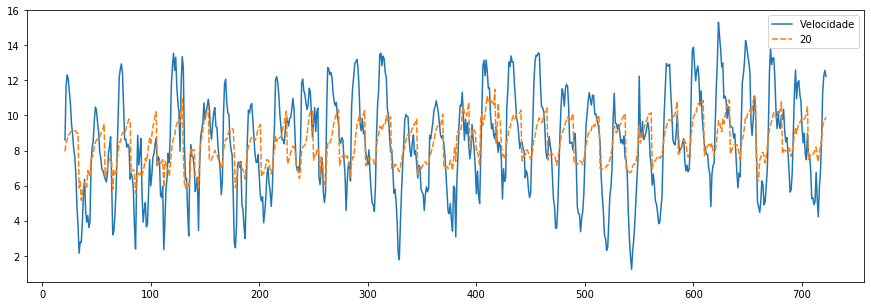

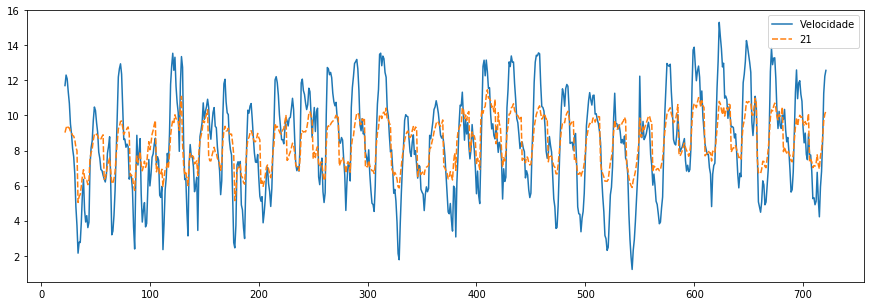

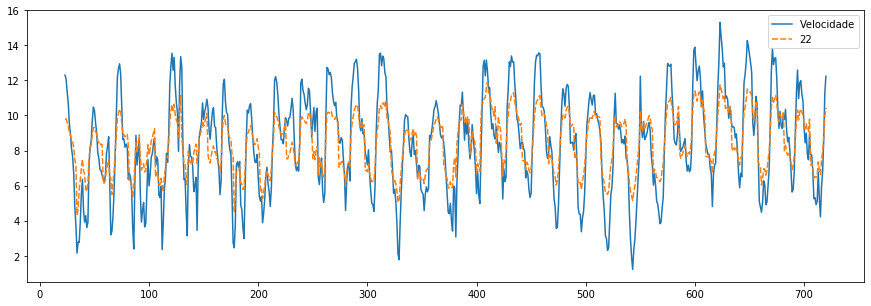

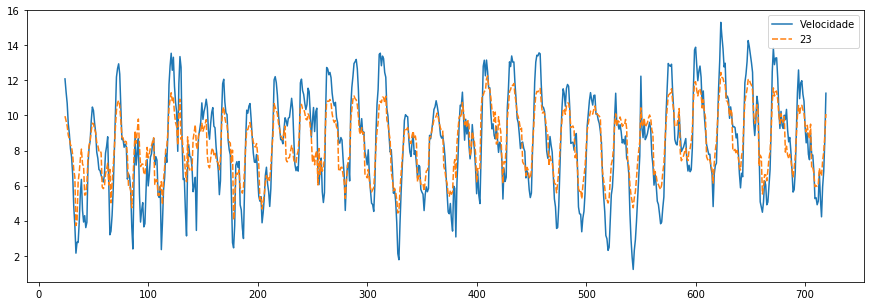

In [53]:
# Plot LassoCV result
_regressplot(df_inter[PREDICTORS].reset_index(drop=True), regress)

---

#### ElasticNetCV

In [54]:
# RidgeCV
regress = GeneralizedLinear(
    df_inter,
    regressors=REGRESSORS,
    predictors=[PREDICTORS],
    time_step=TIME_STEP,
    linear_type="ElasticNetCV"
).run()

regress

/opt/anaconda3/envs/accept-data-analysis/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:1100: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/anaconda3/envs/accept-data-analysis/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:1100: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/anaconda3/envs/accept-data-analysis/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:1100: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/anaconda3/envs/accept-data-analysis/lib/python3.6/site-packages/sklearn/li

,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
0,13.307699,13.293889,13.113193,12.712744,12.043963,11.245848,9.827123,9.707183,9.067088,8.547307,...,6.697361,7.348587,7.510731,7.627904,7.847215,8.277269,8.990637,9.901543,10.639558,11.222919
1,12.931875,12.859463,12.655451,12.268023,11.645777,10.909933,9.521815,9.429746,8.806407,8.303478,...,7.002604,7.607291,7.713899,7.912483,8.170596,8.538182,9.204933,9.991687,10.601854,11.071606
2,12.339578,12.387747,12.311040,12.048965,11.523861,10.852096,9.462872,9.339190,8.665126,8.112707,...,7.160058,7.682036,7.775762,8.036022,8.340184,8.701076,9.281674,9.923720,10.426130,10.819332
3,11.853768,11.929666,11.901149,11.679105,11.209173,10.599176,9.201881,9.102972,8.445674,7.882208,...,7.228000,7.708427,7.812839,8.123911,8.481005,8.862649,9.372284,9.893633,10.312643,10.646278
4,11.208307,11.280848,11.270291,11.088871,10.684438,10.159261,8.782676,8.729981,8.112855,7.567411,...,7.423977,7.829580,7.902591,8.282713,8.678768,9.030957,9.469076,9.859253,10.169411,10.421184
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
739,7.785659,8.220204,8.652211,9.135935,9.434671,9.615264,9.808780,9.687707,9.622518,9.619229,...,9.563744,8.940265,8.661455,8.705753,8.601116,8.428183,8.321247,8.185706,8.038473,7.946539
740,10.065234,9.517374,9.020239,8.651808,8.402931,8.324897,8.406235,8.474825,8.707998,8.940702,...,9.116563,8.987105,8.695384,8.807151,8.757639,8.583028,8.907117,9.237544,9.358474,9.407503
741,11.745930,10.720712,9.745445,8.915068,8.327629,8.024438,7.980446,8.040910,8.315200,8.590437,...,8.747226,8.935032,8.657320,8.830421,8.853053,8.714446,9.337419,9.978837,10.293548,10.456545
742,13.083882,11.748241,10.454046,9.290684,8.438548,7.939275,7.756057,7.763261,8.028097,8.291709,...,8.305937,8.773852,8.542918,8.755739,8.845995,8.780539,9.627866,10.518224,11.007481,11.285095


#### ElasticNetCV - evaluate

In [55]:
# Evaluate forecasting
EN_eval = _mult_regress_evaluate(df_inter[PREDICTORS], regress, "ElasticNetCV")
EN_eval

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
ElasticNetCV (1-Hour),0.829281,0.993271,0.910649,0.883271,1.290496,0.000643,4.935915
ElasticNetCV (2-Hour),0.632482,0.979784,0.795287,1.302815,2.772698,0.001992,5.929907
ElasticNetCV (3-Hour),0.503653,0.971660,0.709685,1.525895,3.740804,0.000228,5.911586
ElasticNetCV (4-Hour),0.409713,0.963513,0.640088,1.680715,4.446421,0.000432,7.038914
ElasticNetCV (5-Hour),0.328300,0.956698,0.572974,1.786058,5.060141,0.003245,7.059203
ElasticNetCV (6-Hour),0.250546,0.949865,0.500545,1.876182,5.649959,0.016609,6.693233
ElasticNetCV (7-Hour),0.215231,0.941655,0.463929,1.895524,5.921564,0.004621,6.980183
ElasticNetCV (8-Hour),0.226933,0.944293,0.476374,1.876538,5.839831,0.007687,6.909962
ElasticNetCV (9-Hour),0.299695,0.952381,0.547444,1.793764,5.296982,0.002376,8.003829
ElasticNetCV (10-Hour),0.412032,0.961853,0.641898,1.638356,4.452899,0.007421,7.705273


#### ElasticNetCV - chart

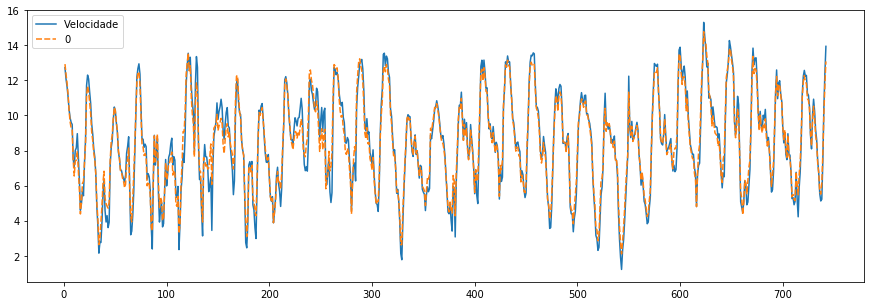

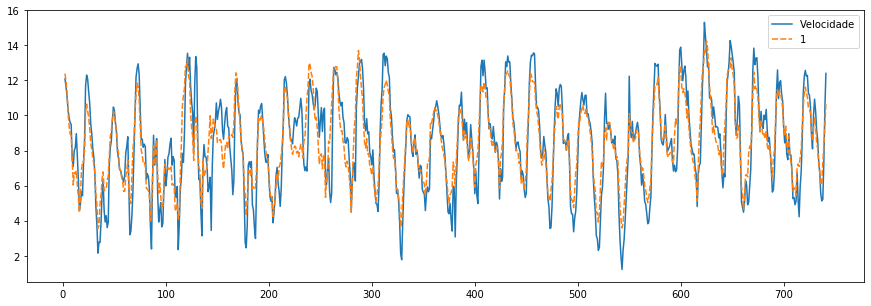

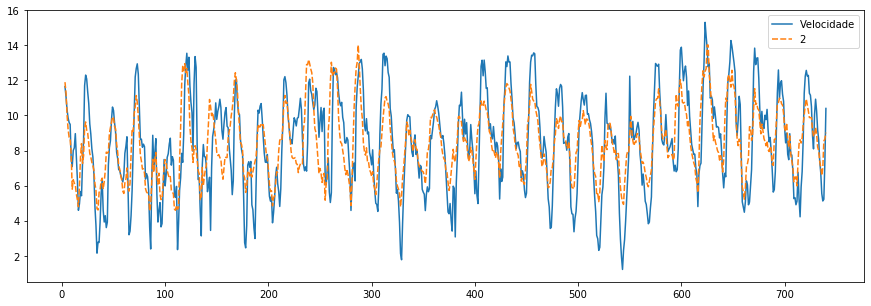

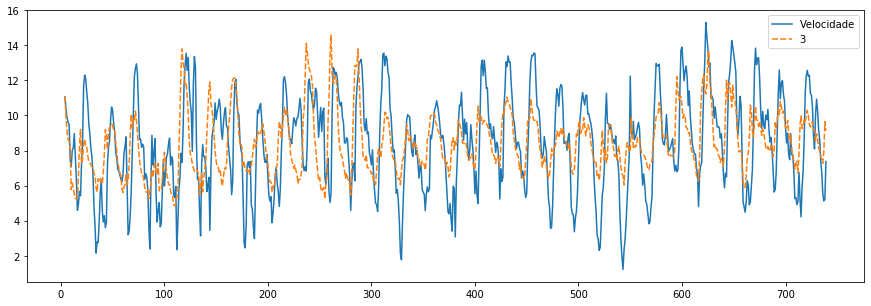

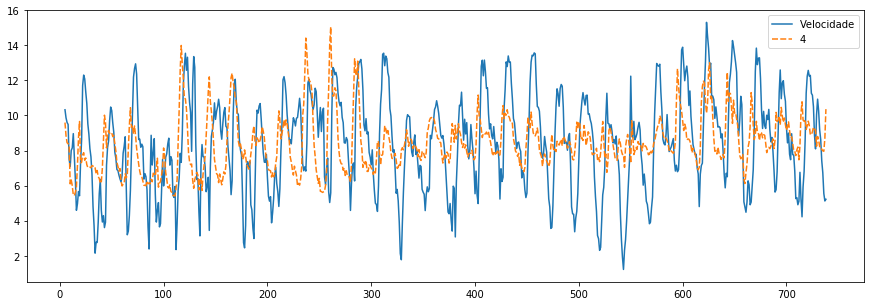

...

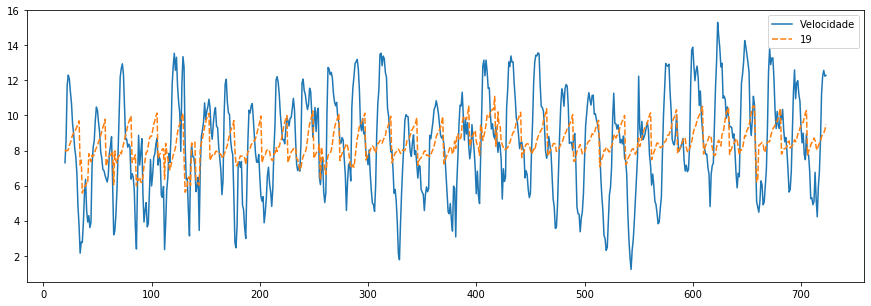

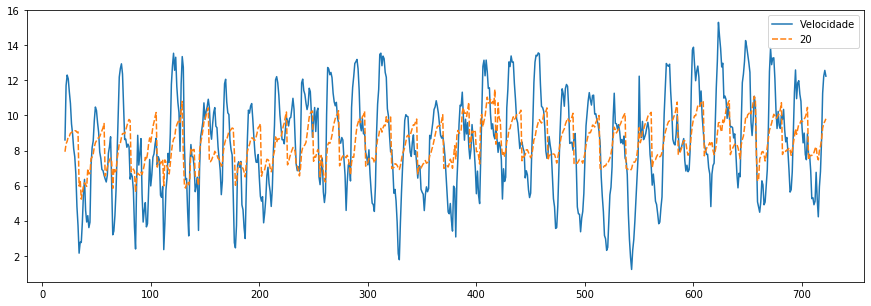

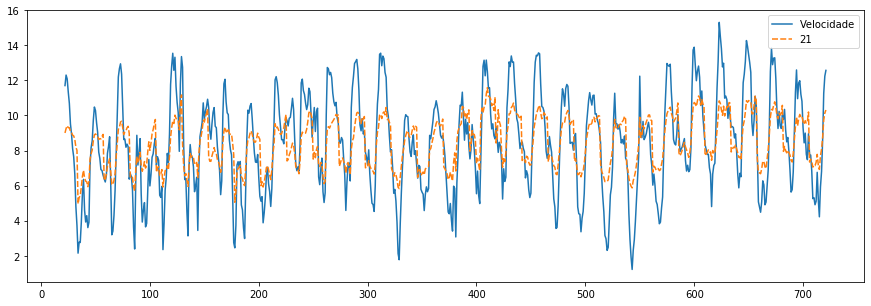

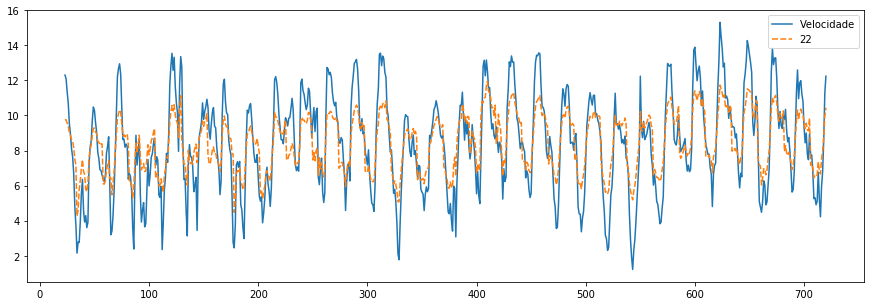

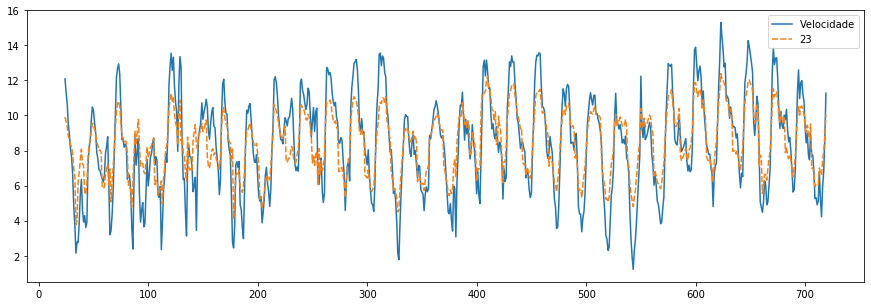

In [56]:
# Plot ElasticNetCV result
_regressplot(df_inter[PREDICTORS].reset_index(drop=True), regress)

---

#### MultiTaskElasticNetCV

In [57]:
# RidgeCV
regress = GeneralizedLinear(
    df_inter,
    regressors=REGRESSORS,
    predictors=[PREDICTORS],
    time_step=TIME_STEP,
    linear_type="MultiTaskElasticNetCV"
).run()

regress

,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
0,13.307699,13.293889,13.113193,12.712744,12.043963,11.245848,9.827123,9.707183,9.067088,8.547307,...,6.697361,7.348587,7.510731,7.627904,7.847215,8.277269,8.990637,9.901543,10.639558,11.222919
1,12.931875,12.859463,12.655451,12.268023,11.645777,10.909933,9.521815,9.429746,8.806407,8.303478,...,7.002604,7.607291,7.713899,7.912483,8.170596,8.538182,9.204933,9.991687,10.601854,11.071606
2,12.339578,12.387747,12.311040,12.048965,11.523861,10.852096,9.462872,9.339190,8.665126,8.112707,...,7.160058,7.682036,7.775762,8.036022,8.340184,8.701076,9.281674,9.923720,10.426130,10.819332
3,11.853768,11.929666,11.901149,11.679105,11.209173,10.599176,9.201881,9.102972,8.445674,7.882208,...,7.228000,7.708427,7.812839,8.123911,8.481005,8.862649,9.372284,9.893633,10.312643,10.646278
4,11.208307,11.280848,11.270291,11.088871,10.684438,10.159261,8.782676,8.729981,8.112855,7.567411,...,7.423977,7.829580,7.902591,8.282713,8.678768,9.030957,9.469076,9.859253,10.169411,10.421184
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
739,7.785659,8.220204,8.652211,9.135935,9.434671,9.615264,9.808780,9.687707,9.622518,9.619229,...,9.563744,8.940265,8.661455,8.705753,8.601116,8.428183,8.321247,8.185706,8.038473,7.946539
740,10.065234,9.517374,9.020239,8.651808,8.402931,8.324897,8.406235,8.474825,8.707998,8.940702,...,9.116563,8.987105,8.695384,8.807151,8.757639,8.583028,8.907117,9.237544,9.358474,9.407503
741,11.745930,10.720712,9.745445,8.915068,8.327629,8.024438,7.980446,8.040910,8.315200,8.590437,...,8.747226,8.935032,8.657320,8.830421,8.853053,8.714446,9.337419,9.978837,10.293548,10.456545
742,13.083882,11.748241,10.454046,9.290684,8.438548,7.939275,7.756057,7.763261,8.028097,8.291709,...,8.305937,8.773852,8.542918,8.755739,8.845995,8.780539,9.627866,10.518224,11.007481,11.285095


#### MultiTaskElasticNetCV - evaluate

In [58]:
# Evaluate forecasting
MT_eval = _mult_regress_evaluate(df_inter[PREDICTORS], regress, "MultiTaskElasticNetCV")
MT_eval

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
MultiTaskElasticNetCV (1-Hour),0.829281,0.993271,0.910649,0.883271,1.290496,0.000643,4.935915
MultiTaskElasticNetCV (2-Hour),0.632482,0.979784,0.795287,1.302815,2.772698,0.001992,5.929907
MultiTaskElasticNetCV (3-Hour),0.503653,0.971660,0.709685,1.525895,3.740804,0.000228,5.911586
MultiTaskElasticNetCV (4-Hour),0.409713,0.963513,0.640088,1.680715,4.446421,0.000432,7.038914
MultiTaskElasticNetCV (5-Hour),0.328300,0.956698,0.572974,1.786058,5.060141,0.003245,7.059203
MultiTaskElasticNetCV (6-Hour),0.250546,0.949865,0.500545,1.876182,5.649959,0.016609,6.693233
MultiTaskElasticNetCV (7-Hour),0.215231,0.941655,0.463929,1.895524,5.921564,0.004621,6.980183
MultiTaskElasticNetCV (8-Hour),0.226933,0.944293,0.476374,1.876538,5.839831,0.007687,6.909962
MultiTaskElasticNetCV (9-Hour),0.299695,0.952381,0.547444,1.793764,5.296982,0.002376,8.003829
MultiTaskElasticNetCV (10-Hour),0.412032,0.961853,0.641898,1.638356,4.452899,0.007421,7.705273


#### MultiTaskElasticNetCV - chart

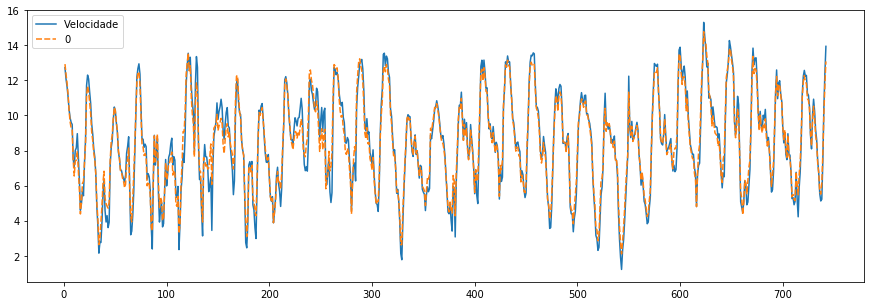

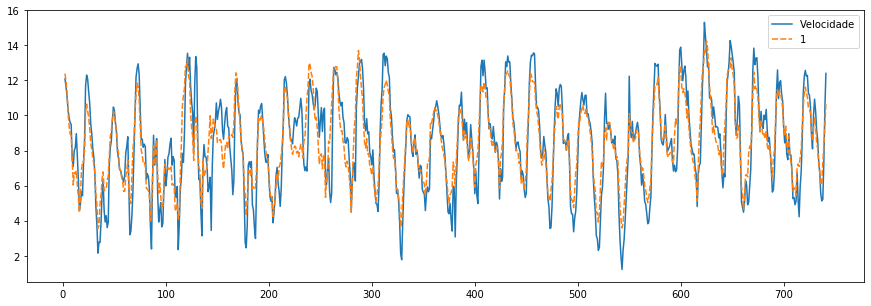

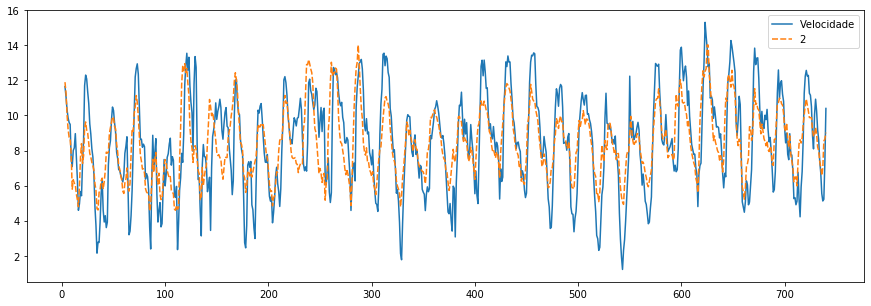

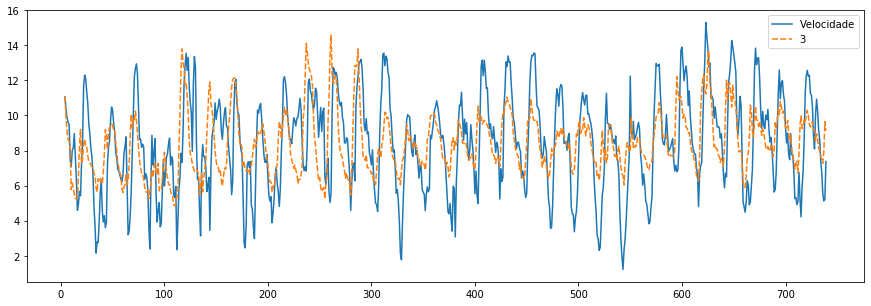

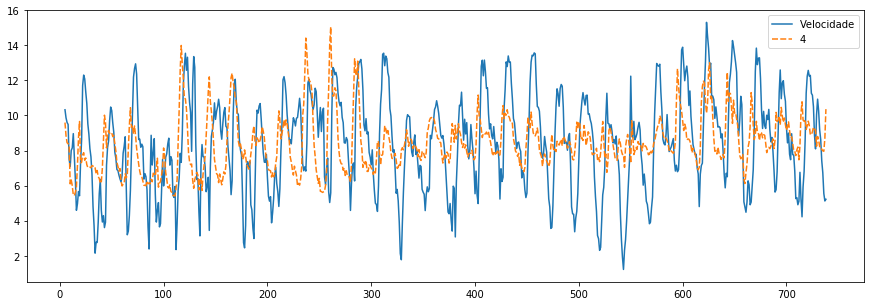

...

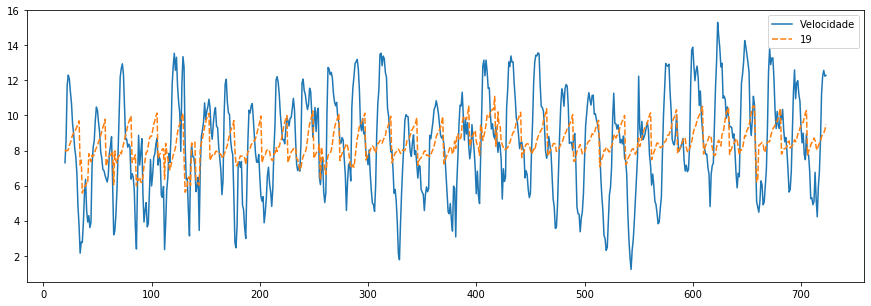

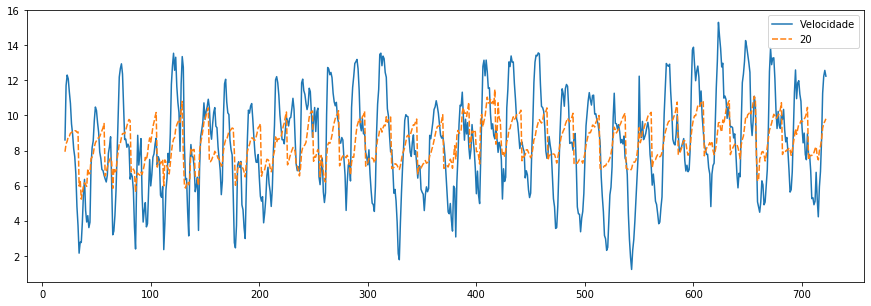

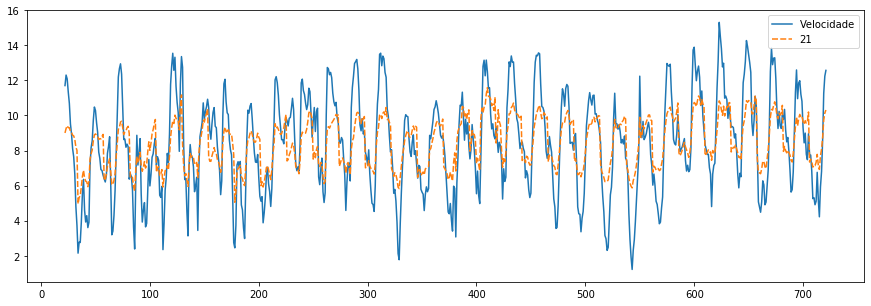

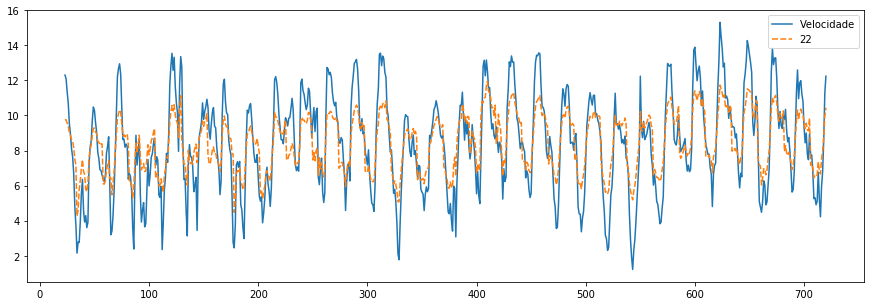

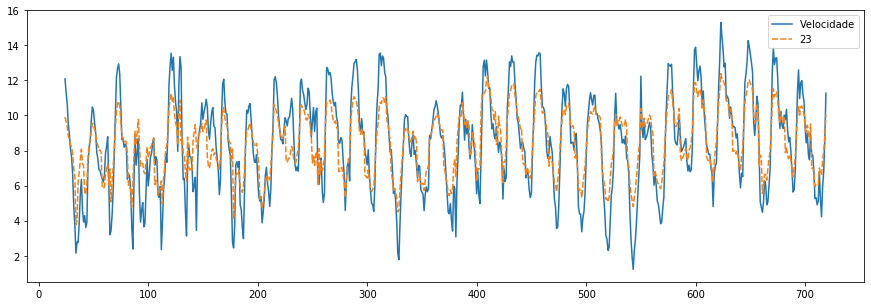

In [59]:
# Plot MultiTaskElasticNetCV result
_regressplot(df_inter[PREDICTORS].reset_index(drop=True), regress)

---

#### GeneralizedLinear - All evaluates

In [60]:
for _ in range(TIME_STEP):
    evals = pd.concat([
        LR_eval.iloc[_],
        R_eval.iloc[_],
        L_eval.iloc[_],
        EN_eval.iloc[_],
        MT_eval.iloc[_]
    ], axis=1)
    display(f"{PREDICTORS} TIME_STEP: {_ + 1}", evals.T)

'Velocidade TIME_STEP: 1'

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (1-Hour),0.830054,0.993271,0.911073,0.881288,1.284549,0.003731,4.965890
RidgeCV (1-Hour),0.829849,0.993271,0.910960,0.881762,1.286118,0.001788,4.963101
LassoCV (1-Hour),0.829221,0.993271,0.910616,0.883062,1.290988,0.001100,4.910141
ElasticNetCV (1-Hour),0.829281,0.993271,0.910649,0.883271,1.290496,0.000643,4.935915
MultiTaskElasticNetCV (1-Hour),0.829281,0.993271,0.910649,0.883271,1.290496,0.000643,4.935915


'Velocidade TIME_STEP: 2'

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (2-Hour),0.634598,0.979784,0.796616,1.296533,2.756552,0.001080,5.915851
RidgeCV (2-Hour),0.634031,0.979784,0.796261,1.298998,2.760844,0.000264,5.920799
LassoCV (2-Hour),0.632508,0.979784,0.795303,1.302708,2.772402,0.002298,5.929870
ElasticNetCV (2-Hour),0.632482,0.979784,0.795287,1.302815,2.772698,0.001992,5.929907
MultiTaskElasticNetCV (2-Hour),0.632482,0.979784,0.795287,1.302815,2.772698,0.001992,5.929907


'Velocidade TIME_STEP: 3'

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (3-Hour),0.507280,0.97031,0.712236,1.519317,3.713156,0.001569,5.871901
RidgeCV (3-Hour),0.506327,0.97166,0.711567,1.521758,3.720362,0.001607,5.880371
LassoCV (3-Hour),0.503729,0.97166,0.709738,1.526450,3.740095,0.002878,5.896717
ElasticNetCV (3-Hour),0.503653,0.97166,0.709685,1.525895,3.740804,0.000228,5.911586
MultiTaskElasticNetCV (3-Hour),0.503653,0.97166,0.709685,1.525895,3.740804,0.000228,5.911586


'Velocidade TIME_STEP: 4'

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (4-Hour),0.413900,0.963513,0.643351,1.673591,4.414596,0.002106,6.999532
RidgeCV (4-Hour),0.412799,0.963513,0.642494,1.676693,4.422927,0.000101,7.008974
LassoCV (4-Hour),0.409809,0.963513,0.640163,1.681419,4.445578,0.007039,7.024381
ElasticNetCV (4-Hour),0.409713,0.963513,0.640088,1.680715,4.446421,0.000432,7.038914
MultiTaskElasticNetCV (4-Hour),0.409713,0.963513,0.640088,1.680715,4.446421,0.000432,7.038914


'Velocidade TIME_STEP: 5'

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (5-Hour),0.332493,0.956698,0.576622,1.779010,5.028243,0.000785,7.012025
RidgeCV (5-Hour),0.331393,0.956698,0.575668,1.781179,5.036575,0.001033,7.023438
LassoCV (5-Hour),0.328297,0.956698,0.572972,1.786109,5.060197,0.000267,7.052648
ElasticNetCV (5-Hour),0.328300,0.956698,0.572974,1.786058,5.060141,0.003245,7.059203
MultiTaskElasticNetCV (5-Hour),0.328300,0.956698,0.572974,1.786058,5.060141,0.003245,7.059203


'Velocidade TIME_STEP: 6'

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (6-Hour),0.254597,0.949865,0.504576,1.865185,5.618947,0.005466,6.623448
RidgeCV (6-Hour),0.253531,0.949865,0.503519,1.869264,5.627039,0.001544,6.640162
LassoCV (6-Hour),0.250636,0.949865,0.500636,1.876242,5.649085,0.000121,6.683700
ElasticNetCV (6-Hour),0.250546,0.949865,0.500545,1.876182,5.649959,0.016609,6.693233
MultiTaskElasticNetCV (6-Hour),0.250546,0.949865,0.500545,1.876182,5.649959,0.016609,6.693233


'Velocidade TIME_STEP: 7'

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (7-Hour),0.216054,0.943012,0.464816,1.894650,5.915268,0.000484,6.990367
RidgeCV (7-Hour),0.215100,0.941655,0.463788,1.895797,5.922523,0.003038,6.979544
LassoCV (7-Hour),0.212503,0.943012,0.460981,1.901348,5.942403,0.000245,6.964053
ElasticNetCV (7-Hour),0.215231,0.941655,0.463929,1.895524,5.921564,0.004621,6.980183
MultiTaskElasticNetCV (7-Hour),0.215231,0.941655,0.463929,1.895524,5.921564,0.004621,6.980183


'Velocidade TIME_STEP: 8'

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (8-Hour),0.229598,0.945652,0.479164,1.868536,5.819492,0.002210,6.884476
RidgeCV (8-Hour),0.228885,0.945652,0.478419,1.871147,5.824907,0.001594,6.905274
LassoCV (8-Hour),0.226966,0.944293,0.476409,1.876442,5.839515,0.002620,6.911374
ElasticNetCV (8-Hour),0.226933,0.944293,0.476374,1.876538,5.839831,0.007687,6.909962
MultiTaskElasticNetCV (8-Hour),0.226933,0.944293,0.476374,1.876538,5.839831,0.007687,6.909962


'Velocidade TIME_STEP: 9'

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (9-Hour),0.302296,0.952381,0.549814,1.787679,5.276409,0.001910,8.014172
RidgeCV (9-Hour),0.301753,0.952381,0.549321,1.789847,5.280523,0.000277,8.032124
LassoCV (9-Hour),0.299908,0.952381,0.547638,1.793711,5.295140,0.005683,8.008669
ElasticNetCV (9-Hour),0.299695,0.952381,0.547444,1.793764,5.296982,0.002376,8.003829
MultiTaskElasticNetCV (9-Hour),0.299695,0.952381,0.547444,1.793764,5.296982,0.002376,8.003829


'Velocidade TIME_STEP: 10'

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (10-Hour),0.414426,0.961853,0.643760,1.636854,4.433794,0.001055,7.664407
RidgeCV (10-Hour),0.414113,0.961853,0.643516,1.638593,4.436175,0.011750,7.664872
LassoCV (10-Hour),0.412338,0.960490,0.642135,1.638215,4.450338,0.000894,7.702876
ElasticNetCV (10-Hour),0.412032,0.961853,0.641898,1.638356,4.452899,0.007421,7.705273
MultiTaskElasticNetCV (10-Hour),0.412032,0.961853,0.641898,1.638356,4.452899,0.007421,7.705273


'Velocidade TIME_STEP: 11'

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (11-Hour),0.488000,0.964529,0.698570,1.527947,3.880768,0.000435,8.075642
RidgeCV (11-Hour),0.487861,0.964529,0.698470,1.528058,3.881827,0.000687,8.076378
LassoCV (11-Hour),0.477768,0.957708,0.691208,1.539089,3.976135,0.007028,8.194977
ElasticNetCV (11-Hour),0.477720,0.957708,0.691173,1.542982,3.986045,0.000643,8.144164
MultiTaskElasticNetCV (11-Hour),0.477720,0.957708,0.691173,1.542982,3.986045,0.000643,8.144164


'Velocidade TIME_STEP: 12'

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (12-Hour),0.493055,0.965847,0.702179,1.521398,3.847592,0.003705,6.958334
RidgeCV (12-Hour),0.492946,0.965847,0.702101,1.521240,3.848416,0.000051,6.969268
LassoCV (12-Hour),0.486528,0.963115,0.697516,1.524109,3.898570,0.000647,7.031965
ElasticNetCV (12-Hour),0.489226,0.964481,0.699447,1.521771,3.877965,0.000664,7.014917
MultiTaskElasticNetCV (12-Hour),0.489226,0.964481,0.699447,1.521771,3.877965,0.000664,7.014917


'Velocidade TIME_STEP: 13'

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (13-Hour),0.408744,0.961696,0.639331,1.661971,4.493571,0.006683,6.835903
RidgeCV (13-Hour),0.408694,0.961696,0.639292,1.661981,4.493950,0.007241,6.849752
LassoCV (13-Hour),0.403047,0.961696,0.634860,1.658651,4.538788,0.001947,6.918323
ElasticNetCV (13-Hour),0.402917,0.961696,0.634757,1.658817,4.540378,0.000598,6.913874
MultiTaskElasticNetCV (13-Hour),0.402917,0.961696,0.634757,1.658817,4.540378,0.000598,6.913874


'Velocidade TIME_STEP: 14'

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (14-Hour),0.309949,0.954795,0.556731,1.837999,5.251317,0.033128,6.845479
RidgeCV (14-Hour),0.309897,0.954795,0.556684,1.837920,5.251711,0.037005,6.854046
LassoCV (14-Hour),0.305494,0.953425,0.552715,1.829901,5.290333,0.006330,6.932541
ElasticNetCV (14-Hour),0.305082,0.953425,0.552342,1.829172,5.294737,0.000117,6.939990
MultiTaskElasticNetCV (14-Hour),0.305082,0.953425,0.552342,1.829172,5.294737,0.000117,6.939990


'Velocidade TIME_STEP: 15'

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (15-Hour),0.261202,0.949246,0.511079,1.943245,5.629441,0.015873,7.121798
RidgeCV (15-Hour),0.261171,0.949246,0.511049,1.943494,5.629678,0.015410,7.124753
LassoCV (15-Hour),0.257269,0.943759,0.507217,1.936351,5.664894,0.002158,7.428039
ElasticNetCV (15-Hour),0.256764,0.942387,0.506719,1.935508,5.670249,0.007019,7.431603
MultiTaskElasticNetCV (15-Hour),0.256764,0.942387,0.506719,1.935508,5.670249,0.007019,7.431603


'Velocidade TIME_STEP: 16'

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (16-Hour),0.244022,0.940934,0.493986,1.967007,5.763759,0.000820,7.185105
RidgeCV (16-Hour),0.244014,0.940934,0.493977,1.966860,5.763825,0.000103,7.189169
LassoCV (16-Hour),0.185051,0.935440,0.430176,2.024410,6.355843,0.009288,7.488548
ElasticNetCV (16-Hour),0.195751,0.935440,0.442438,2.008251,6.236889,0.001053,7.607623
MultiTaskElasticNetCV (16-Hour),0.195751,0.935440,0.442438,2.008251,6.236889,0.001053,7.607623


'Velocidade TIME_STEP: 17'

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (17-Hour),0.249479,0.944979,0.499479,1.945431,5.714873,0.009174,6.884316
RidgeCV (17-Hour),0.249471,0.944979,0.499471,1.945355,5.714937,0.004715,6.887923
LassoCV (17-Hour),0.163006,0.942228,0.403740,2.046068,6.510585,0.001755,6.987318
ElasticNetCV (17-Hour),0.160952,0.940853,0.401188,2.052110,6.549567,0.000240,6.985536
MultiTaskElasticNetCV (17-Hour),0.160952,0.940853,0.401188,2.052110,6.549567,0.000240,6.985536


'Velocidade TIME_STEP: 18'

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (18-Hour),0.261381,0.943526,0.511254,1.916652,5.619803,0.001399,7.277997
RidgeCV (18-Hour),0.261346,0.943526,0.511220,1.916503,5.620070,0.002774,7.278434
LassoCV (18-Hour),0.233395,0.939394,0.483110,1.987246,6.065826,0.002076,7.033359
ElasticNetCV (18-Hour),0.229098,0.938017,0.478642,1.998095,6.133165,0.001971,7.029967
MultiTaskElasticNetCV (18-Hour),0.229098,0.938017,0.478642,1.998095,6.133165,0.001971,7.029967


'Velocidade TIME_STEP: 19'

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (19-Hour),0.260602,0.940690,0.510492,1.917208,5.625678,0.000696,6.877263
RidgeCV (19-Hour),0.260552,0.940690,0.510443,1.917100,5.626061,0.000439,6.884918
LassoCV (19-Hour),0.255674,0.936552,0.505642,1.944259,5.809481,0.000875,6.885239
ElasticNetCV (19-Hour),0.254594,0.936552,0.504573,1.951446,5.851163,0.006483,6.864907
MultiTaskElasticNetCV (19-Hour),0.254594,0.936552,0.504573,1.951446,5.851163,0.006483,6.864907


'Velocidade TIME_STEP: 20'

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (20-Hour),0.260945,0.939227,0.510828,1.923270,5.621562,0.000798,7.145913
RidgeCV (20-Hour),0.260897,0.939227,0.510780,1.923206,5.621933,0.002824,7.151606
LassoCV (20-Hour),0.241587,0.939227,0.491515,1.977031,5.904230,0.002493,6.674964
ElasticNetCV (20-Hour),0.240353,0.937845,0.490258,1.983437,5.944608,0.002984,6.695799
MultiTaskElasticNetCV (20-Hour),0.240353,0.937845,0.490258,1.983437,5.944608,0.002984,6.695799


'Velocidade TIME_STEP: 21'

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (21-Hour),0.300380,0.948824,0.548069,1.886223,5.327732,0.000522,6.574285
RidgeCV (21-Hour),0.300370,0.948824,0.548060,1.886281,5.327807,0.001442,6.576846
LassoCV (21-Hour),0.292178,0.944675,0.540535,1.912016,5.452302,0.005056,6.473648
ElasticNetCV (21-Hour),0.288659,0.944675,0.537270,1.919822,5.493124,0.001383,6.436639
MultiTaskElasticNetCV (21-Hour),0.288659,0.944675,0.537270,1.919822,5.493124,0.001383,6.436639


'Velocidade TIME_STEP: 22'

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (22-Hour),0.363920,0.955679,0.603258,1.784698,4.850547,0.006180,6.425534
RidgeCV (22-Hour),0.363892,0.955679,0.603235,1.784795,4.850759,0.000149,6.423615
LassoCV (22-Hour),0.357014,0.948753,0.597507,1.813434,4.976926,0.008305,6.308706
ElasticNetCV (22-Hour),0.357827,0.948753,0.598186,1.810451,4.953951,0.001124,6.327107
MultiTaskElasticNetCV (22-Hour),0.357827,0.948753,0.598186,1.810451,4.953951,0.001124,6.327107


'Velocidade TIME_STEP: 23'

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (23-Hour),0.423061,0.959778,0.650431,1.662248,4.397081,0.001348,7.306038
RidgeCV (23-Hour),0.423061,0.959778,0.650431,1.662248,4.397081,0.001358,7.306029
LassoCV (23-Hour),0.418167,0.957004,0.646659,1.682908,4.469588,0.001261,7.174188
ElasticNetCV (23-Hour),0.417614,0.957004,0.646231,1.685586,4.469332,0.003055,7.135338
MultiTaskElasticNetCV (23-Hour),0.417614,0.957004,0.646231,1.685586,4.469332,0.003055,7.135338


'Velocidade TIME_STEP: 24'

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (24-Hour),0.457373,0.959722,0.676293,1.571232,4.129988,0.001083,7.536422
RidgeCV (24-Hour),0.457373,0.959722,0.676293,1.571232,4.129988,0.000980,7.536425
LassoCV (24-Hour),0.450491,0.955556,0.671186,1.584105,4.184374,0.002759,7.475355
ElasticNetCV (24-Hour),0.450357,0.955556,0.671086,1.587502,4.187215,0.007273,7.439228
MultiTaskElasticNetCV (24-Hour),0.450357,0.955556,0.671086,1.587502,4.187215,0.007273,7.439228


---

### 13.2 - ARIMA (AutoRegressive Integrated Moving Average)

__arima__
- data_frame: pd.DataFrame
- exogenous: [] = None
- start_p: int = 2
- d: int = None
- start_q: int = 2
- max_p: int = 5
- max_d: int = 2
- max_q: int = 5
- start_P: int = 1
- D: int = None
- start_Q: int = 1
- max_P: int = 2
- max_D: int = 1
- max_Q: int = 2
- max_order: int = 10
- m: int = 1
- seasonal: bool = True
- stationary: bool = False
- information_criterion: str = "aic"
- alpha: float = 0.05
- test: str = "kpss"
- seasonal_test: str = "ocsb"
- stepwise: bool = True
- n_jobs: int = 1
- start_params: [] = None
- trend: str = None
- method: str = None
- transparams: bool = True
- solver: str = "lbfgs"
- maxiter: int = None
- disp: int = 0
- callback=None
- offset_test_args: dict = None
- seasonal_test_args: dict = None
- suppress_warnings: bool = False
- error_action: str = "warn"
- trace: bool = False
- random: bool = False
- random_state: int = None
- n_fits: int = 10
- return_valid_fits: bool = False
- out_of_sample_size: int = 0
- scoring: str = "mse"
- scoring_args: dict = None
- with_intercept: bool = True
- sarimax_kwargs: dict = None
- n_periods: int = 1
- report: bool = False
- return_conf_int: bool = False
- regressors: [str] = None
- **fit_args
    
more in [pmdarima](https://www.alkaline-ml.com/pmdarima/modules/generated/pmdarima.arima.auto_arima.html)

Fit ARIMA: order=(1, 0, 1) seasonal_order=(0, 0, 0, 1); AIC=2235.193, BIC=2253.510, Fit time=0.193 seconds
Fit ARIMA: order=(0, 0, 0) seasonal_order=(0, 0, 0, 1); AIC=3500.197, BIC=3509.355, Fit time=0.019 seconds
Fit ARIMA: order=(1, 0, 0) seasonal_order=(0, 0, 0, 1); AIC=2342.188, BIC=2355.925, Fit time=0.103 seconds
Fit ARIMA: order=(0, 0, 1) seasonal_order=(0, 0, 0, 1); AIC=2800.302, BIC=2814.040, Fit time=0.094 seconds
Fit ARIMA: order=(2, 0, 1) seasonal_order=(0, 0, 0, 1); AIC=2219.945, BIC=2242.842, Fit time=0.279 seconds
Fit ARIMA: order=(2, 0, 0) seasonal_order=(0, 0, 0, 1); AIC=2224.849, BIC=2243.166, Fit time=0.161 seconds
Fit ARIMA: order=(2, 0, 2) seasonal_order=(0, 0, 0, 1); AIC=2203.372, BIC=2230.848, Fit time=1.141 seconds
Fit ARIMA: order=(3, 0, 3) seasonal_order=(0, 0, 0, 1); AIC=2200.704, BIC=2237.338, Fit time=1.220 seconds
Fit ARIMA: order=(2, 0, 3) seasonal_order=(0, 0, 0, 1); AIC=2199.787, BIC=2231.842, Fit time=0.909 seconds
Fit ARIMA: order=(1, 0, 2) seasonal_o

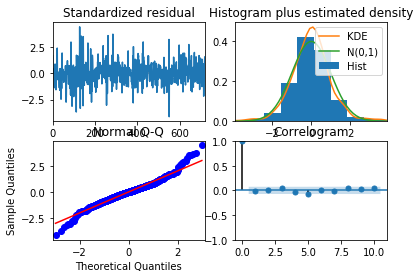

Fit ARIMA: order=(1, 0, 1) seasonal_order=(0, 0, 0, 1); AIC=7573.917, BIC=7592.234, Fit time=0.312 seconds
Fit ARIMA: order=(0, 0, 0) seasonal_order=(0, 0, 0, 1); AIC=7935.918, BIC=7945.077, Fit time=0.018 seconds
Fit ARIMA: order=(1, 0, 0) seasonal_order=(0, 0, 0, 1); AIC=7580.492, BIC=7594.230, Fit time=0.103 seconds
Fit ARIMA: order=(0, 0, 1) seasonal_order=(0, 0, 0, 1); AIC=7700.305, BIC=7714.043, Fit time=0.235 seconds
Fit ARIMA: order=(2, 0, 1) seasonal_order=(0, 0, 0, 1); AIC=7575.412, BIC=7598.308, Fit time=0.270 seconds
Fit ARIMA: order=(1, 0, 2) seasonal_order=(0, 0, 0, 1); AIC=7574.891, BIC=7597.788, Fit time=0.473 seconds
Fit ARIMA: order=(2, 0, 2) seasonal_order=(0, 0, 0, 1); AIC=7575.937, BIC=7603.412, Fit time=0.893 seconds
Total fit time: 2.308 seconds
REPORT(Direção)
                           Statespace Model Results                           
Dep. Variable:                      y   No. Observations:                  720
Model:               SARIMAX(1, 0, 1)   Log Lik

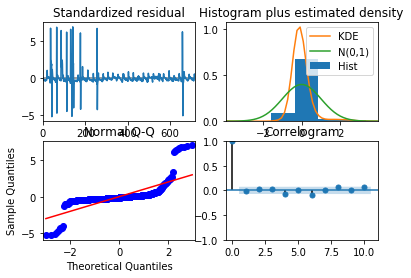

Fit ARIMA: order=(1, 0, 1) seasonal_order=(0, 0, 0, 1); AIC=1441.362, BIC=1459.679, Fit time=0.316 seconds
Fit ARIMA: order=(0, 0, 0) seasonal_order=(0, 0, 0, 1); AIC=2730.796, BIC=2739.955, Fit time=0.019 seconds
Fit ARIMA: order=(1, 0, 0) seasonal_order=(0, 0, 0, 1); AIC=1506.520, BIC=1520.258, Fit time=0.141 seconds
Fit ARIMA: order=(0, 0, 1) seasonal_order=(0, 0, 0, 1); AIC=2065.982, BIC=2079.720, Fit time=0.110 seconds
Fit ARIMA: order=(2, 0, 1) seasonal_order=(0, 0, 0, 1); AIC=1417.479, BIC=1440.376, Fit time=0.894 seconds
Fit ARIMA: order=(2, 0, 0) seasonal_order=(0, 0, 0, 1); AIC=1424.381, BIC=1442.698, Fit time=0.351 seconds
Fit ARIMA: order=(2, 0, 2) seasonal_order=(0, 0, 0, 1); AIC=1413.062, BIC=1440.537, Fit time=1.106 seconds
Fit ARIMA: order=(3, 0, 3) seasonal_order=(0, 0, 0, 1); AIC=1416.831, BIC=1453.465, Fit time=1.655 seconds
Fit ARIMA: order=(1, 0, 2) seasonal_order=(0, 0, 0, 1); AIC=1430.567, BIC=1453.464, Fit time=0.445 seconds
Fit ARIMA: order=(3, 0, 2) seasonal_o

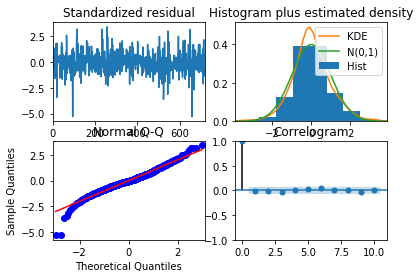

Fit ARIMA: order=(1, 0, 1) seasonal_order=(0, 0, 0, 1); AIC=3803.658, BIC=3821.975, Fit time=0.307 seconds
Fit ARIMA: order=(0, 0, 0) seasonal_order=(0, 0, 0, 1); AIC=5100.123, BIC=5109.281, Fit time=0.020 seconds
Fit ARIMA: order=(1, 0, 0) seasonal_order=(0, 0, 0, 1); AIC=3914.862, BIC=3928.600, Fit time=0.181 seconds
Fit ARIMA: order=(0, 0, 1) seasonal_order=(0, 0, 0, 1); AIC=4398.610, BIC=4412.348, Fit time=0.155 seconds
Fit ARIMA: order=(2, 0, 1) seasonal_order=(0, 0, 0, 1); AIC=3796.372, BIC=3819.268, Fit time=0.735 seconds
Fit ARIMA: order=(2, 0, 0) seasonal_order=(0, 0, 0, 1); AIC=3794.496, BIC=3812.813, Fit time=0.325 seconds
Fit ARIMA: order=(3, 0, 1) seasonal_order=(0, 0, 0, 1); AIC=3798.492, BIC=3825.968, Fit time=0.563 seconds
Fit ARIMA: order=(3, 0, 0) seasonal_order=(0, 0, 0, 1); AIC=3796.480, BIC=3819.376, Fit time=0.339 seconds
Total fit time: 2.628 seconds
REPORT(Umidade)
                           Statespace Model Results                           
Dep. Variable:     

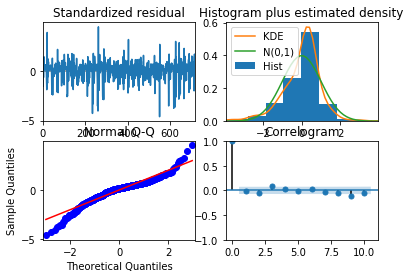

Fit ARIMA: order=(1, 1, 1) seasonal_order=(0, 0, 0, 1); AIC=4006.091, BIC=4024.402, Fit time=0.648 seconds
Fit ARIMA: order=(0, 1, 0) seasonal_order=(0, 0, 0, 1); AIC=4087.747, BIC=4096.903, Fit time=0.023 seconds
Fit ARIMA: order=(1, 1, 0) seasonal_order=(0, 0, 0, 1); AIC=4088.471, BIC=4102.205, Fit time=0.064 seconds
Fit ARIMA: order=(0, 1, 1) seasonal_order=(0, 0, 0, 1); AIC=4087.914, BIC=4101.648, Fit time=0.091 seconds
Fit ARIMA: order=(2, 1, 1) seasonal_order=(0, 0, 0, 1); AIC=3982.735, BIC=4005.625, Fit time=0.280 seconds
Fit ARIMA: order=(2, 1, 0) seasonal_order=(0, 0, 0, 1); AIC=4075.138, BIC=4093.450, Fit time=0.131 seconds
Fit ARIMA: order=(2, 1, 2) seasonal_order=(0, 0, 0, 1); AIC=3975.669, BIC=4003.136, Fit time=0.401 seconds
Fit ARIMA: order=(3, 1, 3) seasonal_order=(0, 0, 0, 1); AIC=3944.726, BIC=3981.349, Fit time=0.895 seconds
Fit ARIMA: order=(2, 1, 3) seasonal_order=(0, 0, 0, 1); AIC=3975.842, BIC=4007.887, Fit time=0.650 seconds
Fit ARIMA: order=(3, 1, 2) seasonal_o

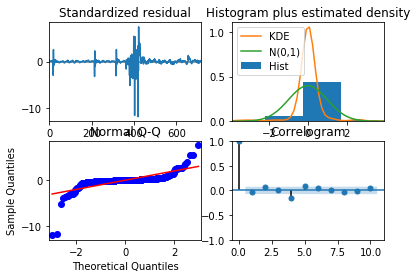

In [61]:
# Apply ARIMA
predict = arima(
    df_inter[COLUMNS][:-24],
    start_p=1,
    start_q=1,
    test='adf',
    max_p=3,
    max_q=3,
    start_P=0,
    D=0,
#     seasonal=False,
    trace=True,
    error_action='ignore',
    suppress_warnings=True,
    report=True,
    return_conf_int=True,
    time_step=24,
)

In [62]:
# Show forecasting of ARIMA
predict

,Velocidade_pred,Velocidade_lconf,Velocidade_uconf,Direção_pred,Direção_lconf,Direção_uconf,Temperatura_pred,Temperatura_lconf,Temperatura_uconf,Umidade_pred,Umidade_lconf,Umidade_uconf,Pressão_pred,Pressão_lconf,Pressão_uconf
0,12.014707,9.854095,14.175319,86.572812,-4.143416,177.289041,25.004921,23.752645,26.257197,89.908329,83.340871,96.475788,1019.448027,1012.166463,1026.729591
1,12.028342,8.613802,15.442881,82.312967,-21.669257,186.295192,24.809738,22.890235,26.729241,89.449152,78.910417,99.987886,1019.652381,1010.157819,1029.146944
2,11.933963,7.821866,16.046060,79.227552,-31.077982,189.533087,24.634414,22.270323,26.998505,88.709890,75.630502,101.789277,1019.848012,1009.803967,1029.892057
3,11.601833,7.012584,16.191083,76.992780,-36.489230,190.474790,24.485087,21.816428,27.153746,87.963733,73.375281,102.552184,1020.074727,1009.778715,1030.370739
4,11.101898,6.213286,15.990510,75.374130,-39.739254,190.487513,24.364882,21.495924,27.233840,87.319704,71.883401,102.756007,1020.206725,1009.862701,1030.550749
5,10.502849,5.450289,15.555410,74.201738,-41.758308,190.161783,24.274416,21.283152,27.265680,86.806575,70.915074,102.698075,1020.294958,1009.897191,1030.692725
6,9.867369,4.743066,14.991672,73.352572,-43.049182,189.754325,24.212342,21.154208,27.270477,86.417328,70.290728,102.543928,1020.301751,1009.852696,1030.750806
7,9.248721,4.104578,14.392864,72.737519,-43.895291,189.370329,24.175888,21.086934,27.264841,86.131781,69.887759,102.375803,1020.281736,1009.706856,1030.856615
8,8.688692,3.543707,13.833676,72.292035,-44.461808,189.045878,24.161351,21.061945,27.260758,85.927377,69.626391,102.228364,1020.230937,1009.474319,1030.987556
9,8.216755,3.067763,13.365746,71.969370,-44.847918,188.786658,24.164548,21.063538,27.265558,85.783793,69.455860,102.111725,1020.186679,1009.156083,1031.217276


#### evaluate

In [63]:
# Evaluate forecasting
AR_eval = _regress_evaluate(
    df_inter[PREDICTORS][-24:].values,
    predict[f"{PREDICTORS}_pred"].values,
    f"ARIMA ({24}-Hour)"
)
AR_eval

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
ARIMA (24-Hour),0.314205,1.0,0.56054,1.730006,5.5882,0.025575,6.165995


#### chart

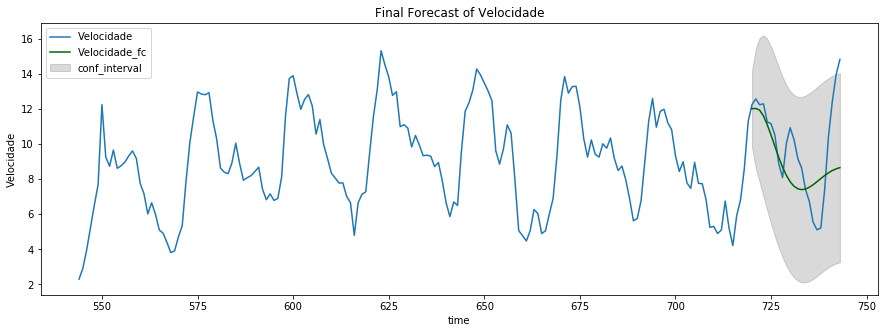

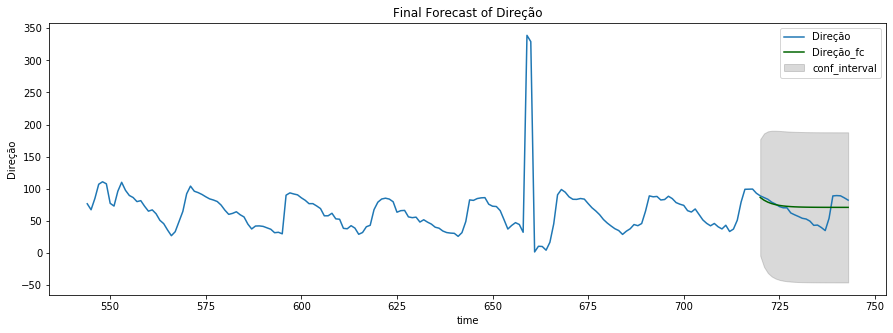

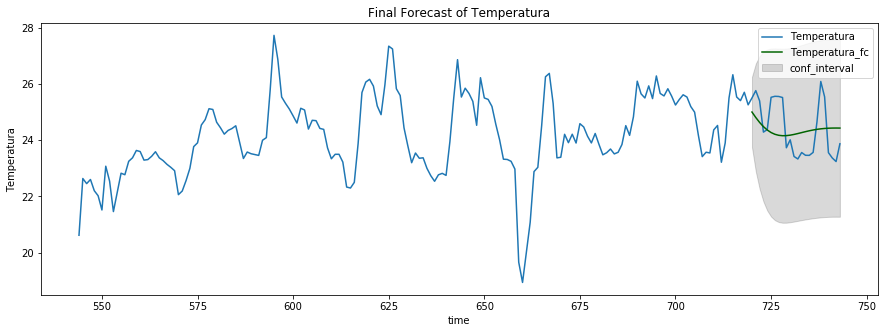

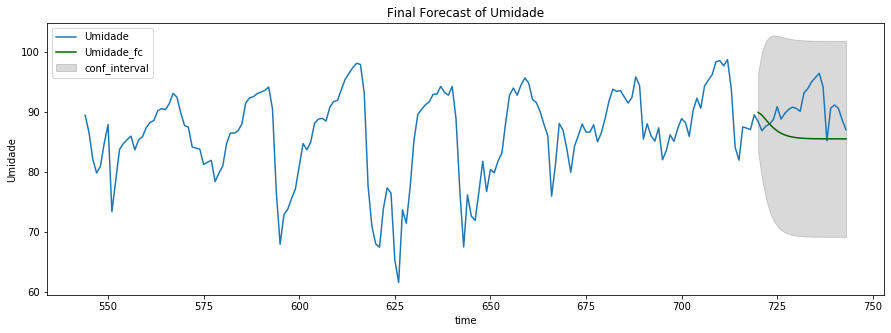

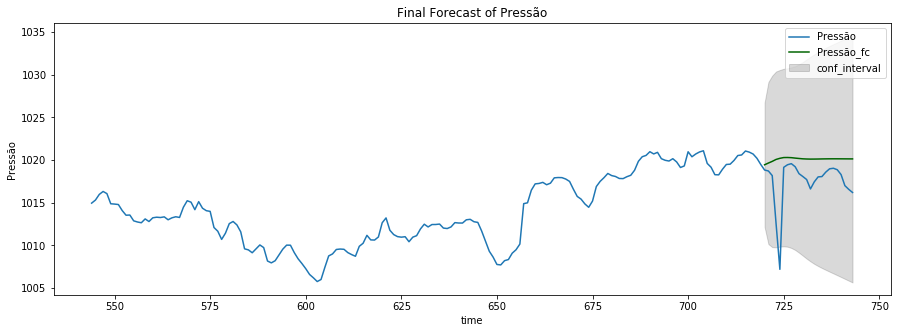

In [64]:
# Plot results of ARIMA forecasting
_mlineplot(
    df_inter[COLUMNS].reset_index(drop=True),
    predict=predict,
    title={c:f'Final Forecast of {c}' for c in COLUMNS},
    true_offset=-200,
    conf_interval=True
)

---

### 13.3 - SSA (Singular Spectrum Analysis)

In [237]:
# Time step for use in all models
TIME_STEP = 24

# Define column name to regressors and predictors
REGRESSORS = "so2"
PREDICTORS = "so2"

from dataset.ssa_core import ssa, ssa_predict, ssaview, inv_ssa, ssa_cutoff_order
from dataset.mpl_utils import set_mpl_theme
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 5

SSA decomposes original series into trend components and noise. There is chart of original series, reconstructed from first 4 components and residuals.

In [247]:
df_temp = df_inter.interpolate(method='pchip')
describe_data(df_temp)
# ssaview(df_inter[PREDICTORS].values, 24, [0,1,2,3])

ValueError: `x` must be strictly increasing sequence.

Plot residuals

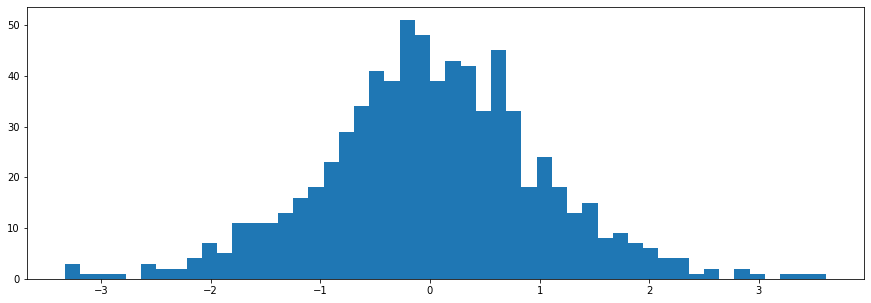

In [67]:
pc, _, v = ssa(df_inter[PREDICTORS].values, 24)
reconstructed = inv_ssa(pc, v, [0,1,2,3])
noise = df_inter[PREDICTORS].values - reconstructed
plt.hist(noise, 50);

Reduce embedding space dimension by finding minimal lag

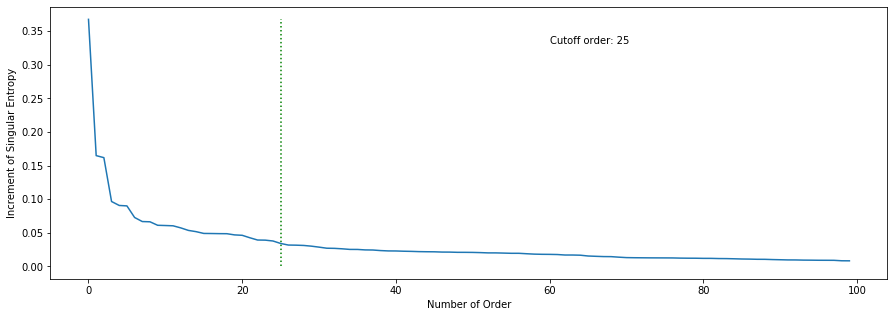

In [68]:
MAX_LAG_NUMBER = 100
n_co = ssa_cutoff_order(df_inter[PREDICTORS].values, dim=MAX_LAG_NUMBER, show_plot=True)

In [69]:
hours_to_predict = 24
forecast = ssa_predict(
    df_inter[PREDICTORS][:-24].values, n_co, list(range(8)), hours_to_predict, 1e-5
)
forecast

array([12.51802361, 13.80462474, 13.98035784, 13.01765138, 11.53428525,
       10.02678323,  9.03451592,  8.90982985,  9.06053152,  9.02907888,
        8.77449567,  7.98294053,  7.09590771,  6.36115091,  5.81705854,
        5.64909767,  5.59893843,  5.58919221,  5.950275  ,  6.35464726,
        6.82092302,  7.77069789,  9.04126862, 10.43460521])

#### evaluate

In [70]:
# Evaluate forecasting
SSA_eval = _regress_evaluate(
    df_inter[PREDICTORS][-24:].values,
    forecast,
    "SSA (24-Hour)"
)
SSA_eval

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
SSA (24-Hour),0.565565,1.0,0.752041,1.670087,4.70529,0.030385,4.903176


##### chart

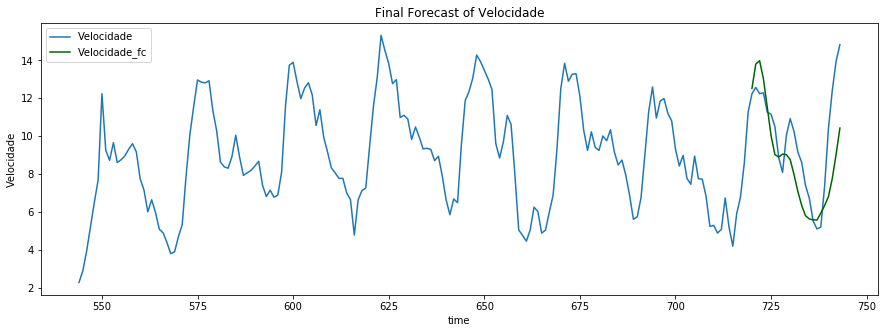

In [71]:
# # Plot results of ARIMA forecasting
_mlineplot(
    df_inter[[PREDICTORS]].reset_index(drop=True),
    predict=pd.DataFrame({f"{PREDICTORS}_pred": forecast}),
    title={c:f'Final Forecast of {c}' for c in COLUMNS},
    true_offset=-200
)

In [72]:
rcParams['figure.figsize'] = 6, 4

---

#### All regressions evalute

In [73]:
evals = pd.concat([
    LR_eval.iloc[23],
    R_eval.iloc[23],
    L_eval.iloc[23],
    EN_eval.iloc[23],
    MT_eval.iloc[23],
    AR_eval.iloc[0],
    SSA_eval.iloc[0],
], axis=1)
display(f"{PREDICTORS} TIME_STEP: 24", evals.T)

'Velocidade TIME_STEP: 24'

,r_squared,fac_2,pearson_r,mae,mse,min_error,max_error
LinearRegression (24-Hour),0.457373,0.959722,0.676293,1.571232,4.129988,0.001083,7.536422
RidgeCV (24-Hour),0.457373,0.959722,0.676293,1.571232,4.129988,0.000980,7.536425
LassoCV (24-Hour),0.450491,0.955556,0.671186,1.584105,4.184374,0.002759,7.475355
ElasticNetCV (24-Hour),0.450357,0.955556,0.671086,1.587502,4.187215,0.007273,7.439228
MultiTaskElasticNetCV (24-Hour),0.450357,0.955556,0.671086,1.587502,4.187215,0.007273,7.439228
ARIMA (24-Hour),0.314205,1.000000,0.560540,1.730006,5.588200,0.025575,6.165995
SSA (24-Hour),0.565565,1.000000,0.752041,1.670087,4.705290,0.030385,4.903176


---

### 13.4 - Logistic regression

__logistic_regression__
- data_frame: pd.DataFrame
- penalty: str = "l2"
- dual: bool = False
- tol: float = 1e-4
- C: float = 1.0
- fit_intercept: bool = True
- intercept_scaling: float = 1
- class_weight: dict or str = None
- random_state: int or str = None
- solver: str = "liblinear"
- max_iter: int = 100
- multi_class: str = "ovr"
- verbose: int = 0
- warm_start: bool = False
- n_jobs: int = None
- l1_ratio: float = None
- offset: int = 1
- regressors: [str] = None
- predictors: [str] = None

more in [scikit LogisticRegression](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html#sklearn.linear_model.LogisticRegression)

#### pre-processing

In [74]:
# Define column name to classifier and classified
CLASSIFIER = "Temperatura"
CLASSIFIED = "temp_status"

In [75]:
# Pre-processing (create classifier)

# Calculate lower and upper limit
upper = describe_m.loc[CLASSIFIER, "limite superior"]
lower = describe_m.loc[CLASSIFIER, "limite inferior"]

# Copy the dataframe and classifies column (Temperatura)
# 3 for above of upper limit, 2 for below lower limite, 0 otherwise
df_aux = df_inter.copy()
df_aux[CLASSIFIED] = df_aux[CLASSIFIER].apply(
    lambda r: 2 if r > upper else 1 if r < lower else 0
)

# Get true values
true = df_aux[CLASSIFIED]

#### logistic regression

In [76]:
# Logistic regression
pred = logistic_regression(
    df_aux, predictors=[CLASSIFIED]
)[f"{CLASSIFIED}_predict"]

/opt/anaconda3/envs/accept-data-analysis/lib/python3.6/site-packages/sklearn/utils/validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


#### evaluate

In [77]:
# Evaluate logistic regression
cm, metrics, accuracy = _class_evaluate(true, pred)
display("confusion matrix:", cm)
display("evaluating:", metrics)
display(f"accuracy: {accuracy}")

'confusion matrix:'

,0,1,2
0,725,0,0
1,1,2,0
2,4,0,12


'evaluating:'

,precision,recall,f1
0,0.993151,1.000000,0.996564
1,1.000000,0.666667,0.800000
2,1.000000,0.750000,0.857143


'accuracy: 0.9932795698924731'

---

**Developed by: Patrick Ferraz <patrick.ferraz@outlook.com> | [GitHub](https://github.com/patricksferraz)**